# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [10]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(3, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [4]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [5]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, num_classes=n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), dim=1)
    #### END CODE HERE ####
    return combined

In [20]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [7]:
mnist_shape = (3, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
image_path = 'resized_emoji_challenge'
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.Resize((28, 28)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataset = ImageFolder(image_path, transform=transform)

dataloader = DataLoader(
    dataset,
    batch_size=batch_size,
    shuffle=True)

NameError: name 'ImageFolder' is not defined

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [12]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [13]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [14]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.213564725637436, discriminator loss: 0.2537344219908118


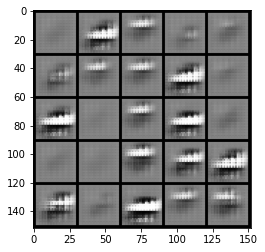

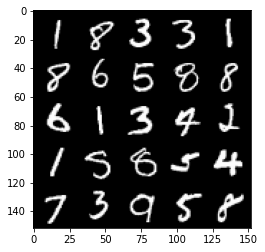

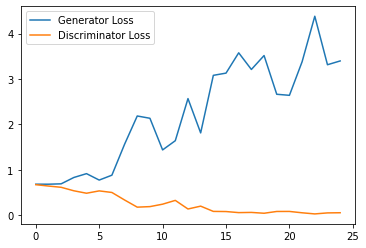

Step 1000: Generator loss: 4.232859129905701, discriminator loss: 0.040990041064098474


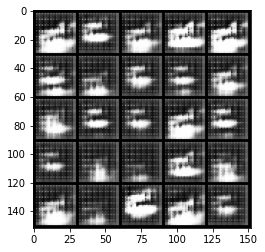

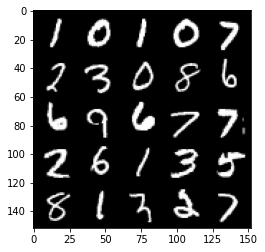

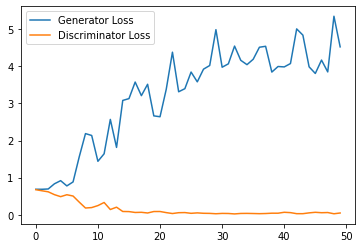

Step 1500: Generator loss: 4.465882359981537, discriminator loss: 0.058909173311665654


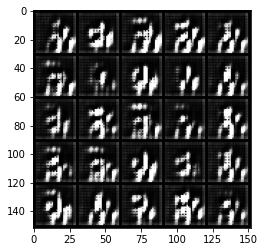

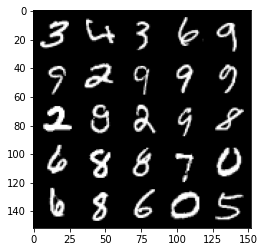

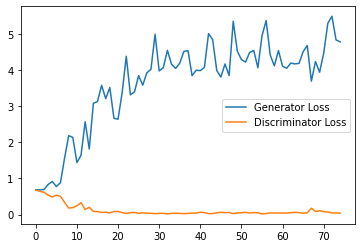

Step 2000: Generator loss: 3.447200919151306, discriminator loss: 0.13092659090459347


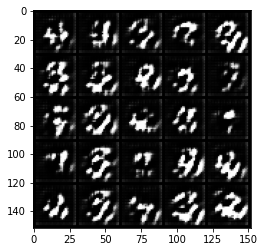

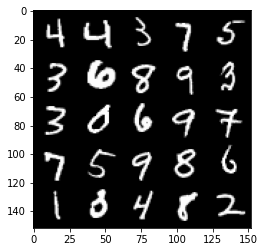

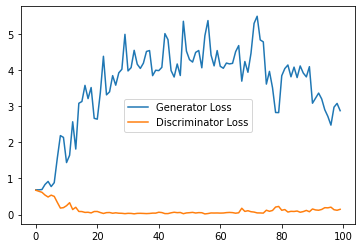

Step 2500: Generator loss: 2.8034378526210784, discriminator loss: 0.2176929011642933


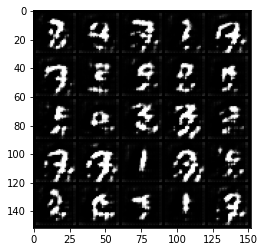

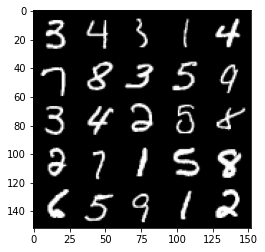

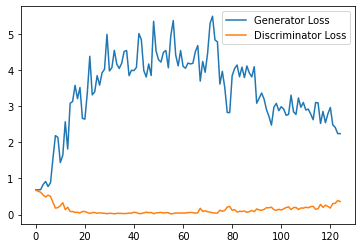

Step 3000: Generator loss: 2.411821281671524, discriminator loss: 0.2853571644425392


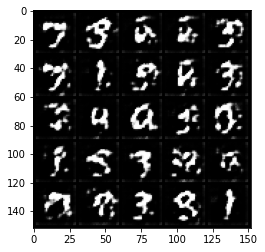

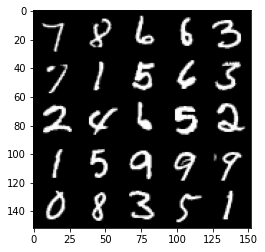

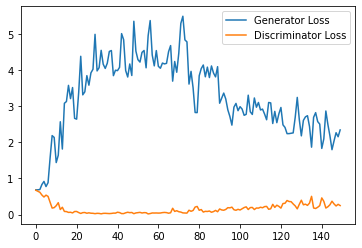

Step 3500: Generator loss: 2.2030937542915345, discriminator loss: 0.334886654779315


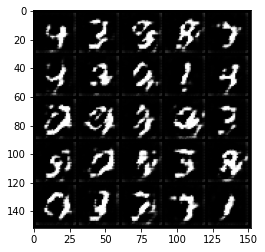

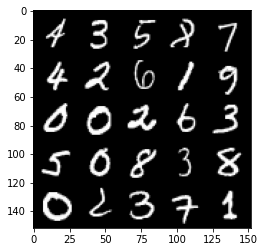

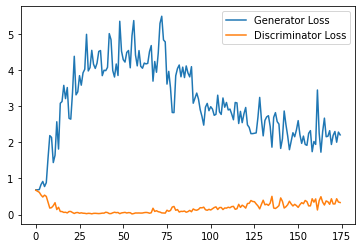

Step 4000: Generator loss: 2.0221247589588165, discriminator loss: 0.33957829082012175


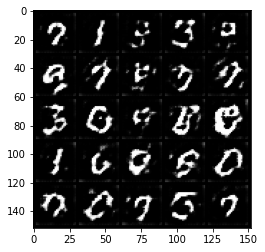

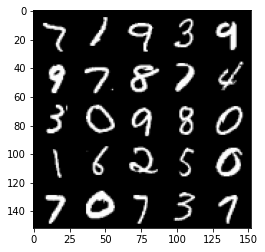

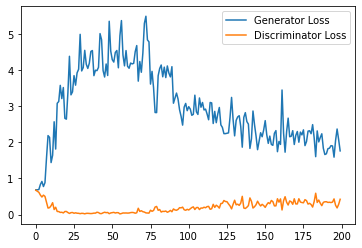

Step 4500: Generator loss: 1.9050759274959563, discriminator loss: 0.3363320134878159


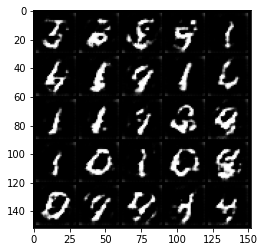

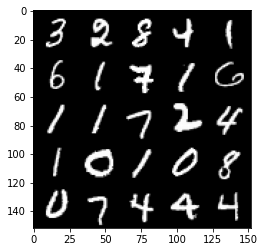

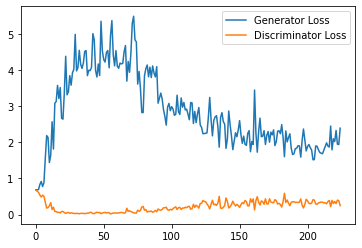

Step 5000: Generator loss: 2.009941733121872, discriminator loss: 0.3508558549880981


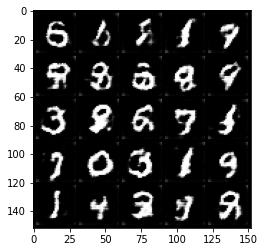

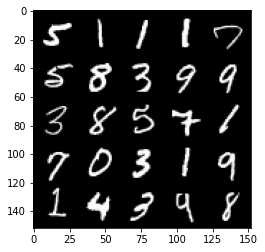

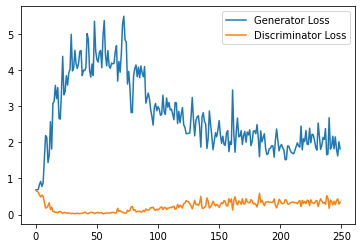

Step 5500: Generator loss: 1.916709403038025, discriminator loss: 0.3830159730017185


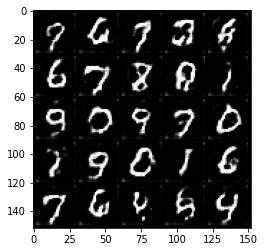

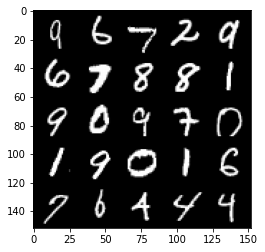

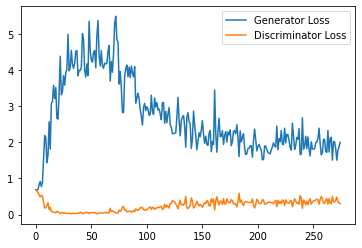

Step 6000: Generator loss: 1.7856564573049545, discriminator loss: 0.4031778296530247


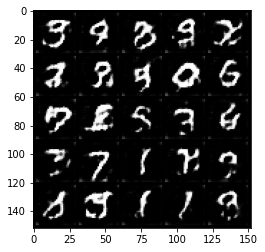

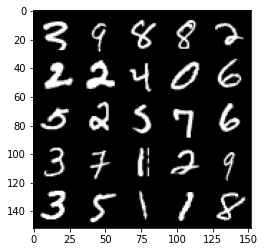

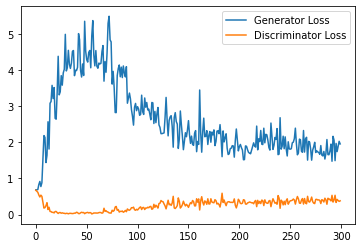

Step 6500: Generator loss: 1.6666507682800293, discriminator loss: 0.408147824883461


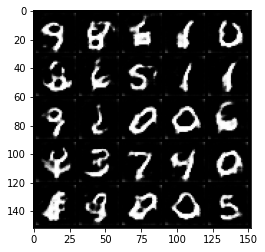

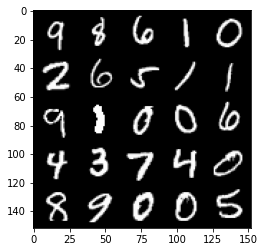

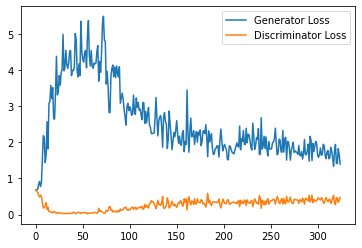

Step 7000: Generator loss: 1.6321154140233993, discriminator loss: 0.4271928831934929


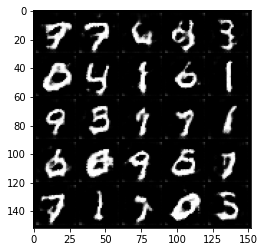

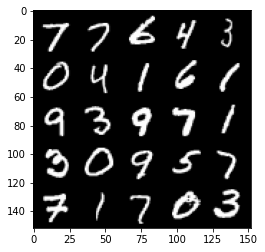

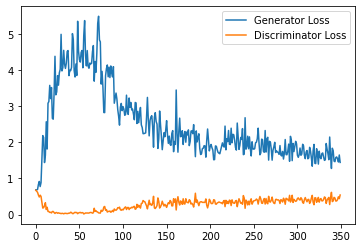

Step 7500: Generator loss: 1.525713057398796, discriminator loss: 0.4509294027388096


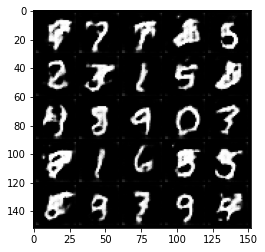

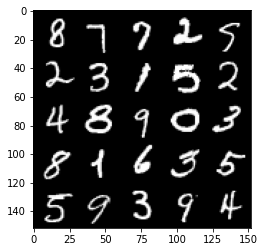

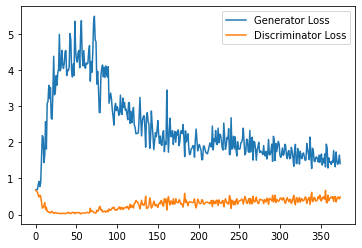

Step 8000: Generator loss: 1.4056915179491043, discriminator loss: 0.4717263987660408


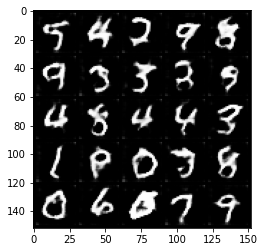

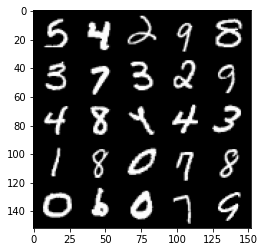

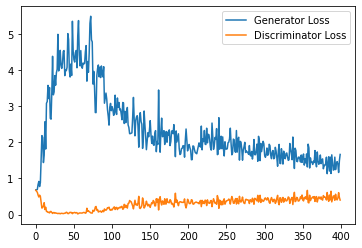

Step 8500: Generator loss: 1.398855123281479, discriminator loss: 0.4916006885766983


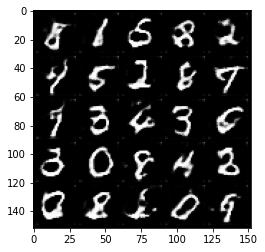

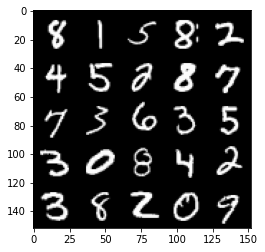

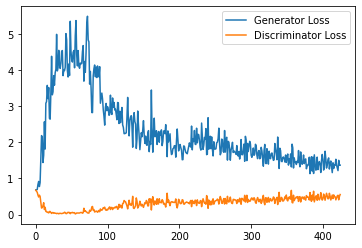

Step 9000: Generator loss: 1.42404687666893, discriminator loss: 0.5010354642271996


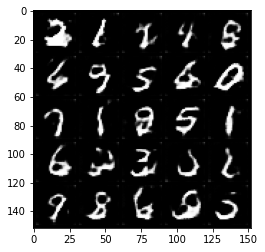

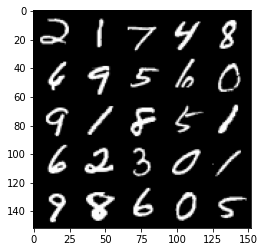

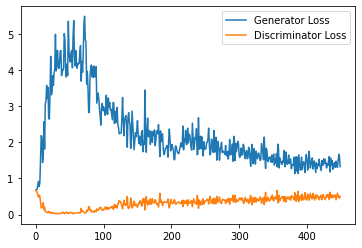

Step 9500: Generator loss: 1.401039323091507, discriminator loss: 0.5268449890017509


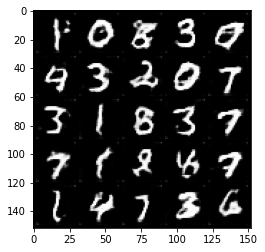

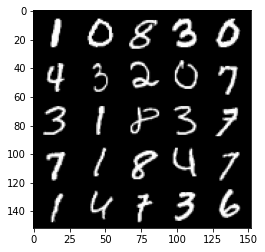

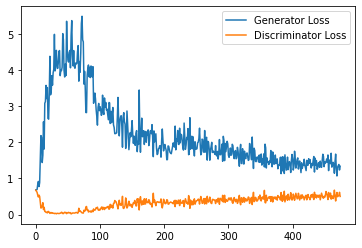

Step 10000: Generator loss: 1.2951678804159164, discriminator loss: 0.5269287672042847


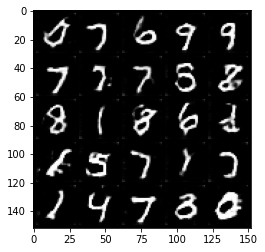

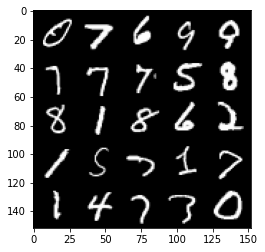

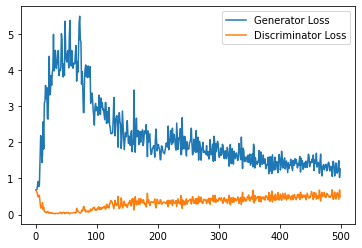

Step 10500: Generator loss: 1.2417944469451905, discriminator loss: 0.5309281585216522


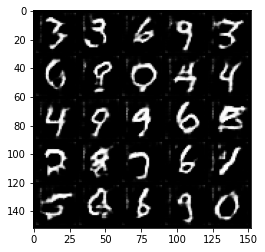

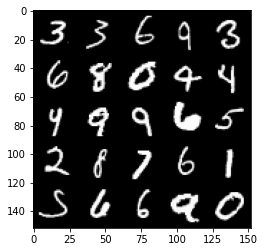

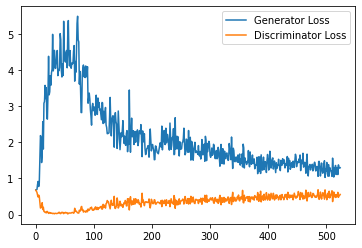

Step 11000: Generator loss: 1.207820485472679, discriminator loss: 0.5342555280327796


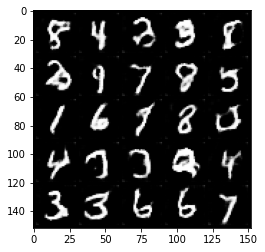

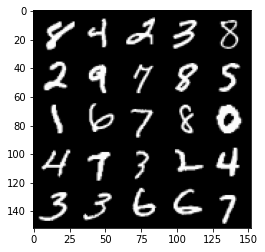

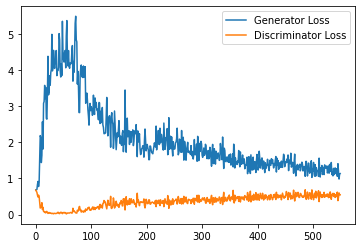

Step 11500: Generator loss: 1.2545620646476745, discriminator loss: 0.5358464447259903


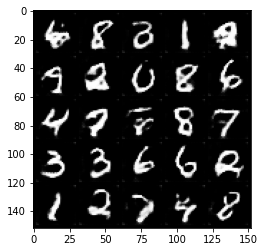

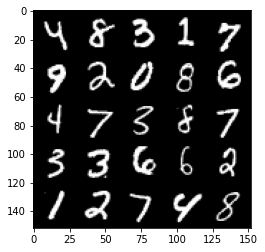

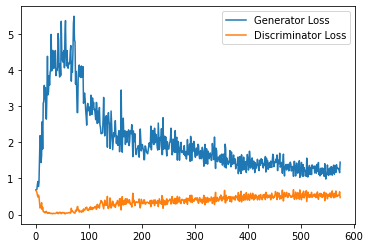

Step 12000: Generator loss: 1.2275837562084198, discriminator loss: 0.5413288187980652


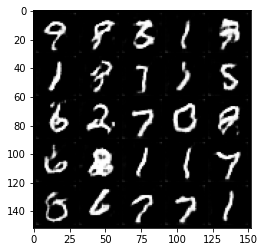

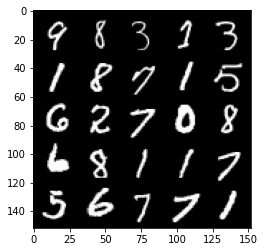

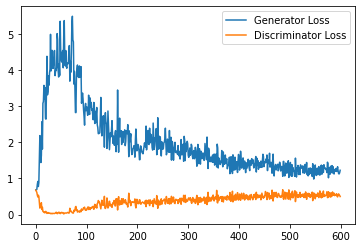

Step 12500: Generator loss: 1.1858539836406707, discriminator loss: 0.5413990253806115


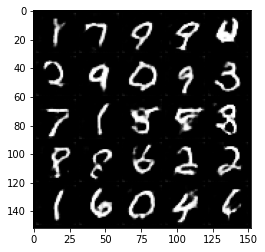

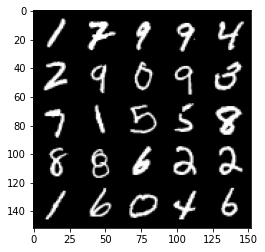

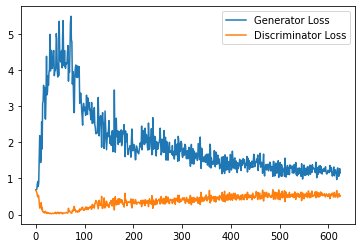

Step 13000: Generator loss: 1.1894316452741622, discriminator loss: 0.5458443278670311


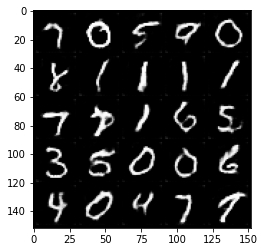

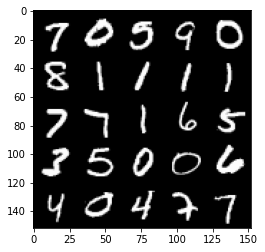

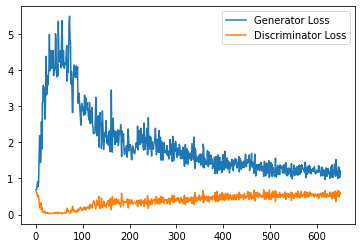

Step 13500: Generator loss: 1.1759953063726425, discriminator loss: 0.5545645262002945


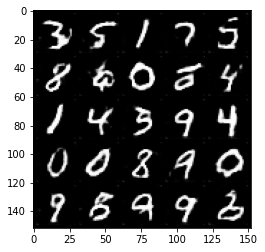

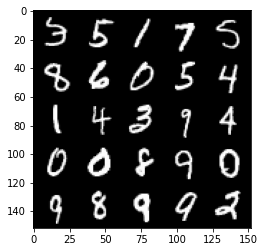

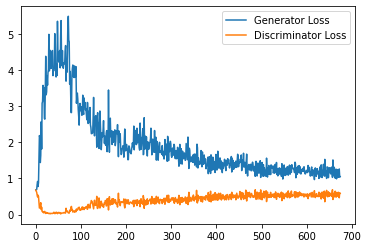

Step 14000: Generator loss: 1.1773331934213638, discriminator loss: 0.5504958952069282


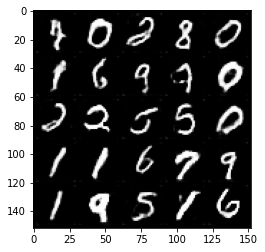

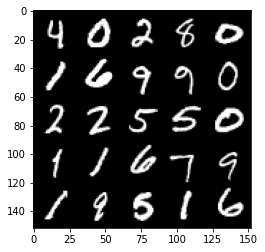

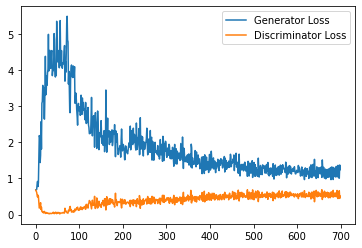

Step 14500: Generator loss: 1.2024155858755112, discriminator loss: 0.5596539677381516


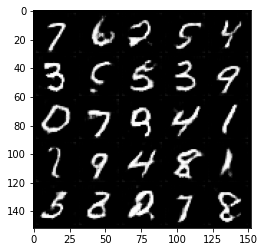

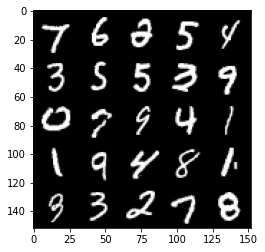

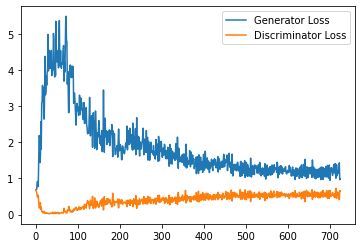

Step 15000: Generator loss: 1.156430226445198, discriminator loss: 0.5557701603770256


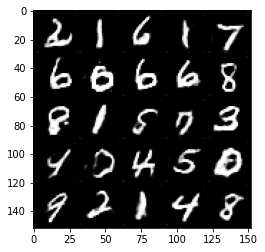

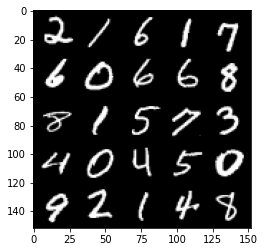

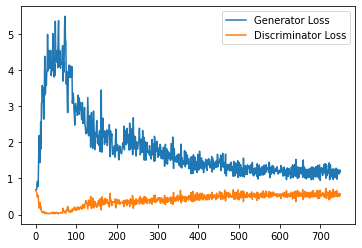

Step 15500: Generator loss: 1.1477809938192367, discriminator loss: 0.5589108826518059


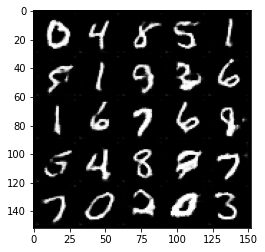

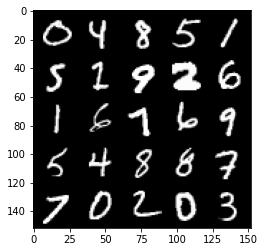

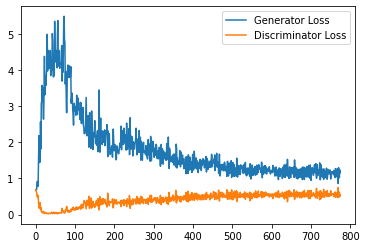

Step 16000: Generator loss: 1.1215849885940552, discriminator loss: 0.5657283552289009


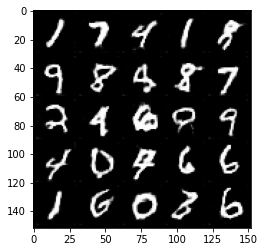

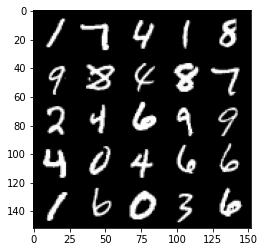

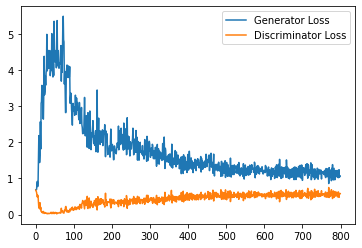

Step 16500: Generator loss: 1.1121831313371657, discriminator loss: 0.5618321915864944


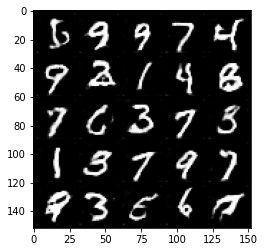

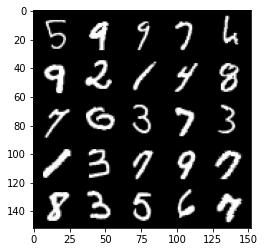

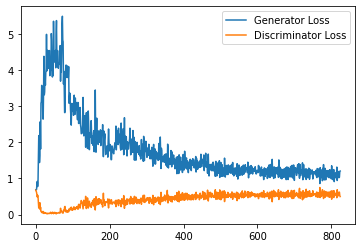

Step 17000: Generator loss: 1.0767328000068666, discriminator loss: 0.5701650292873383


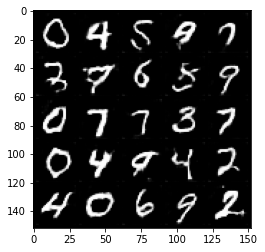

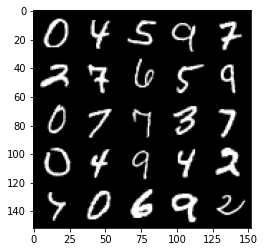

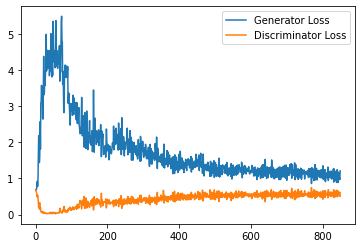

Step 17500: Generator loss: 1.0809155552387237, discriminator loss: 0.5770504115223885


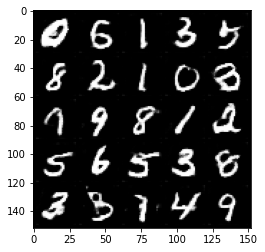

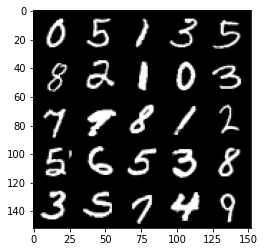

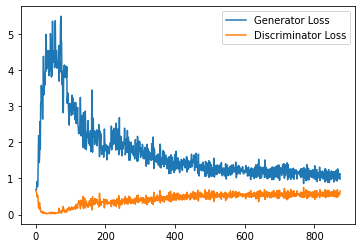

Step 18000: Generator loss: 1.1319613636732102, discriminator loss: 0.5691137014627456


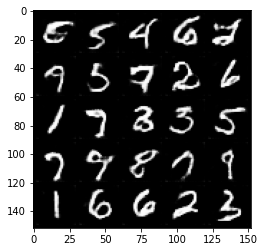

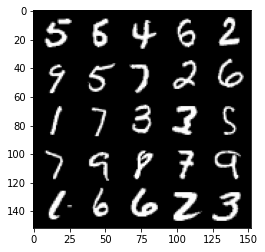

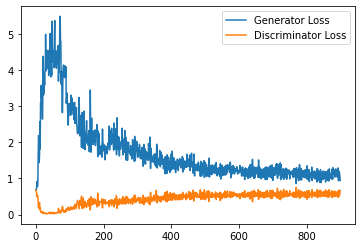

Step 18500: Generator loss: 1.083192273259163, discriminator loss: 0.5725305366516114


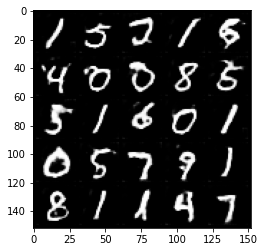

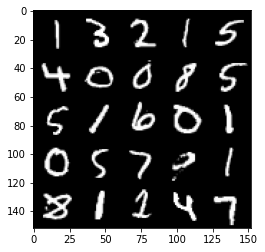

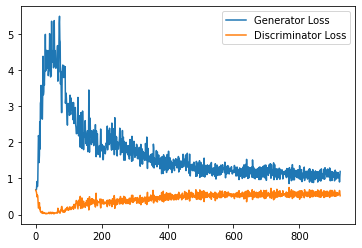

Step 19000: Generator loss: 1.0988306015729905, discriminator loss: 0.574136699616909


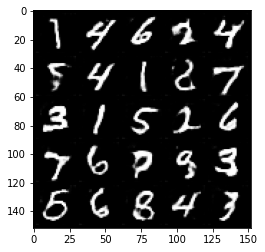

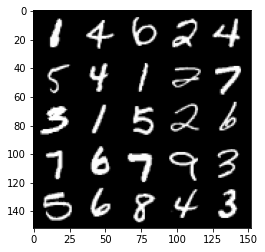

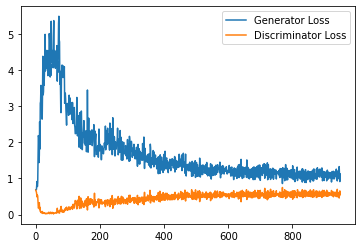

Step 19500: Generator loss: 1.0673884727954865, discriminator loss: 0.576301577091217


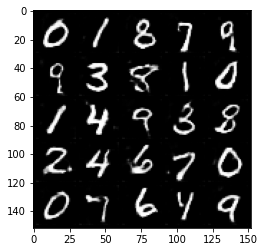

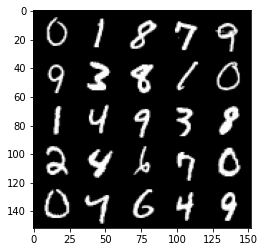

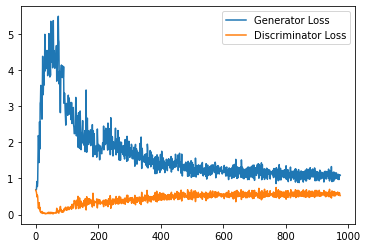

Step 20000: Generator loss: 1.0732386479377747, discriminator loss: 0.5799476222991944


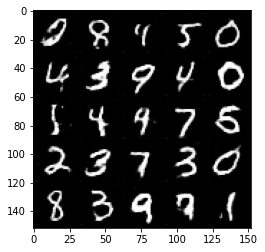

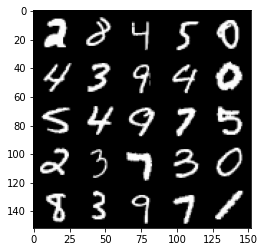

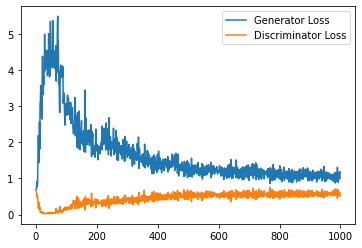

Step 20500: Generator loss: 1.077904927968979, discriminator loss: 0.5835576959252358


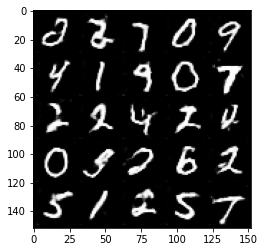

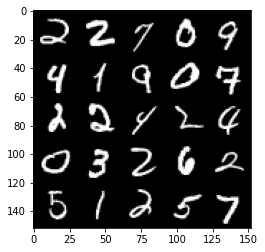

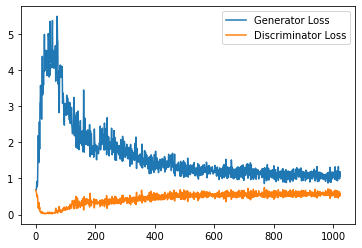

Step 21000: Generator loss: 1.0726486929655075, discriminator loss: 0.5818194996714592


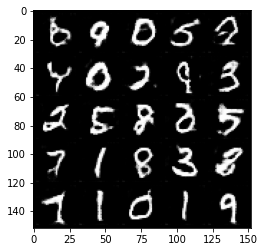

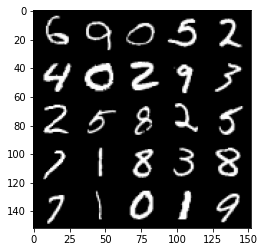

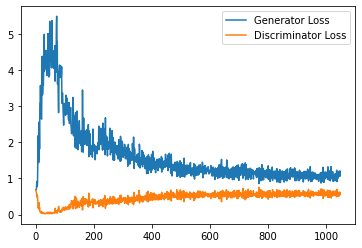

Step 21500: Generator loss: 1.0753516161441803, discriminator loss: 0.5812507972121239


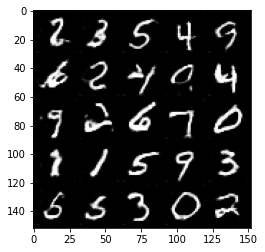

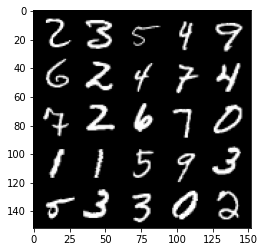

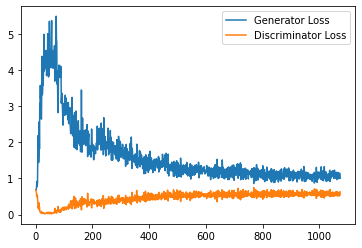

Step 22000: Generator loss: 1.0469011378288269, discriminator loss: 0.5841929090619087


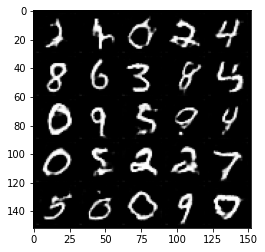

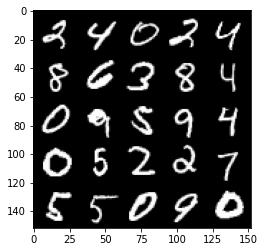

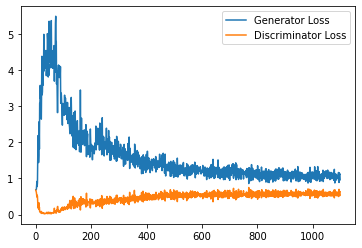

Step 22500: Generator loss: 1.0442676371335984, discriminator loss: 0.5871167242527008


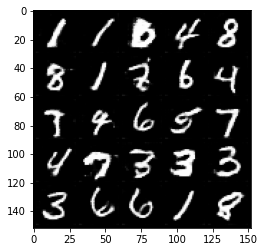

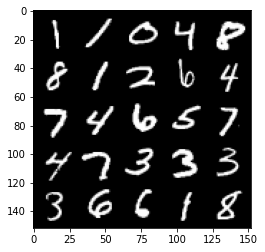

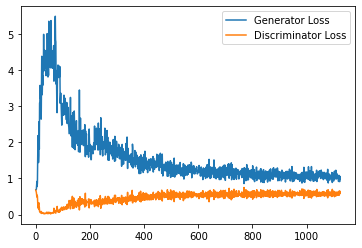

Step 23000: Generator loss: 1.0577425270080567, discriminator loss: 0.5799952624440193


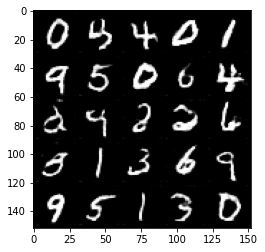

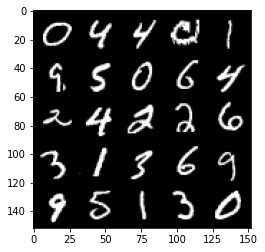

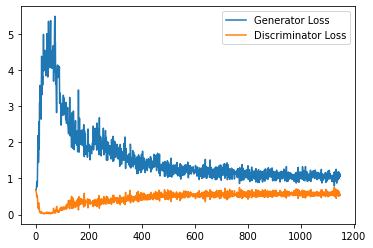

Step 23500: Generator loss: 1.0495056459903718, discriminator loss: 0.5843269111514091


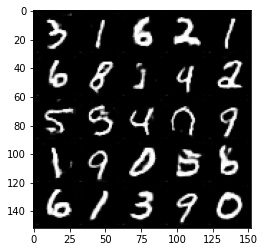

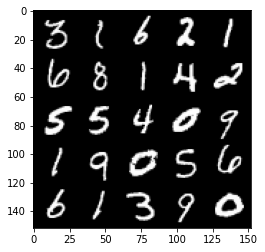

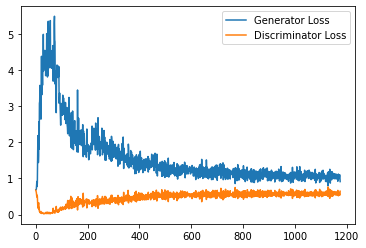

Step 24000: Generator loss: 1.03139970266819, discriminator loss: 0.5869676631689071


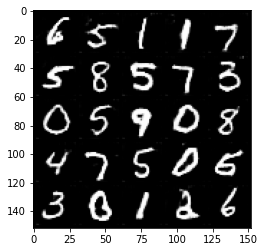

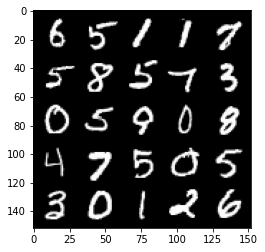

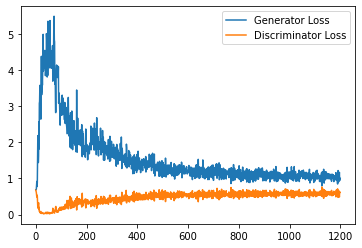

Step 24500: Generator loss: 1.0469554668664933, discriminator loss: 0.590287780880928


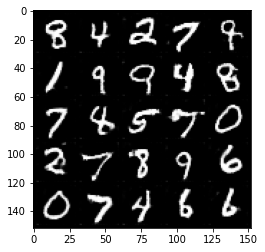

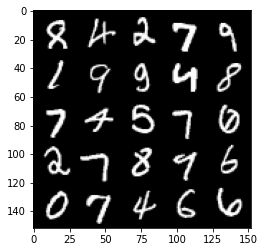

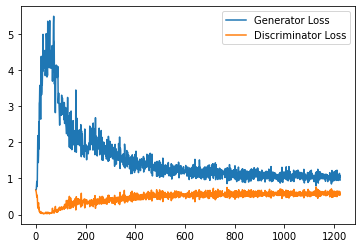

Step 25000: Generator loss: 1.01387360227108, discriminator loss: 0.588593017756939


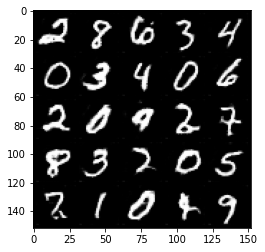

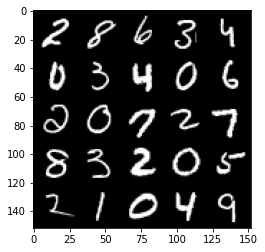

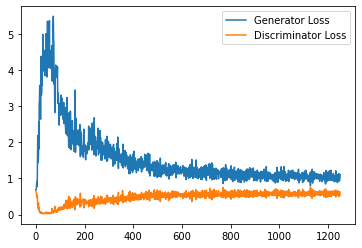

Step 25500: Generator loss: 1.044456957578659, discriminator loss: 0.5890122111439705


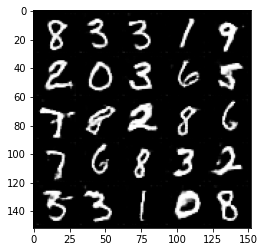

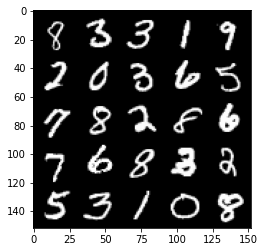

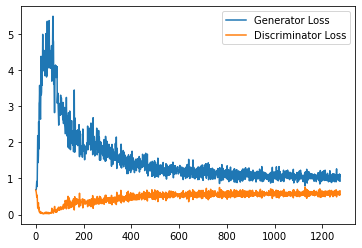

Step 26000: Generator loss: 1.0482608159780502, discriminator loss: 0.5899886754155159


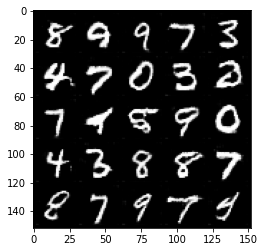

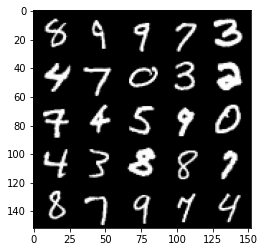

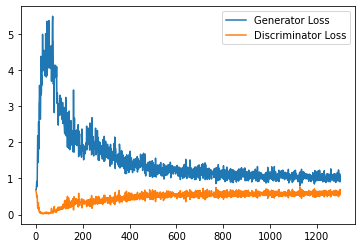

Step 26500: Generator loss: 1.0389835679531096, discriminator loss: 0.588795822918415


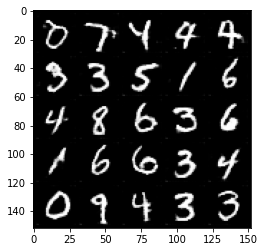

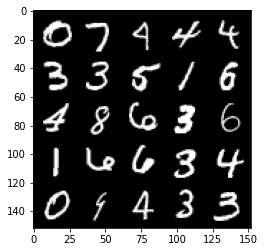

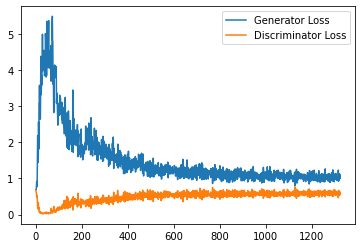

Step 27000: Generator loss: 1.007927449464798, discriminator loss: 0.59033828997612


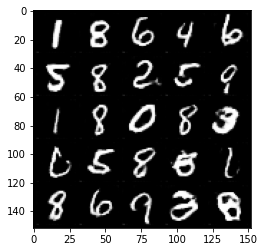

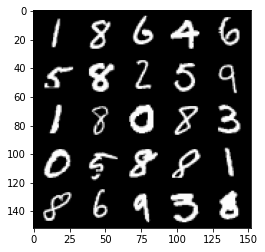

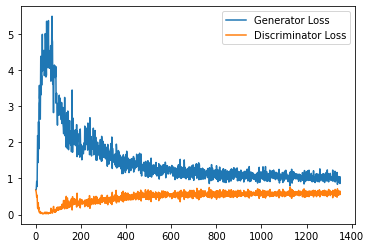

Step 27500: Generator loss: 1.0122378768920899, discriminator loss: 0.5914785903692246


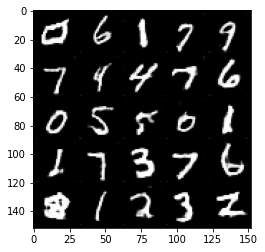

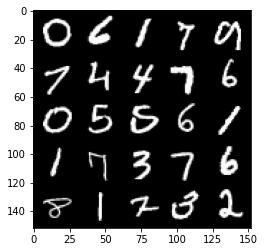

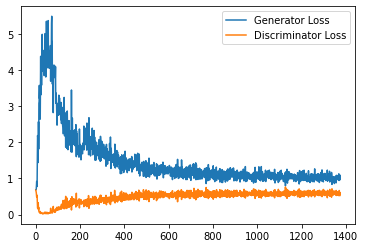

Step 28000: Generator loss: 1.0406527518033981, discriminator loss: 0.5922285828590393


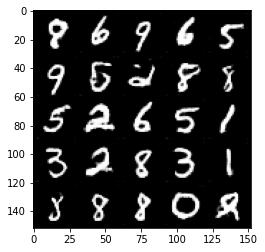

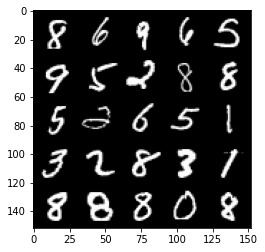

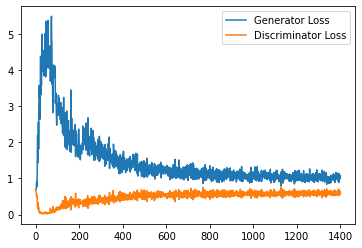

Step 28500: Generator loss: 1.0264201806783677, discriminator loss: 0.5917466080188751


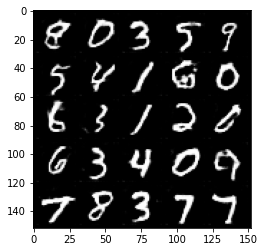

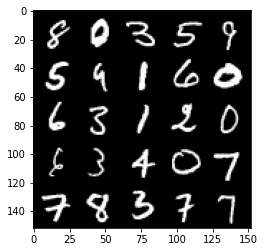

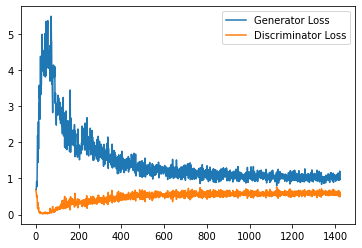

Step 29000: Generator loss: 1.0081485401391983, discriminator loss: 0.5949285644888878


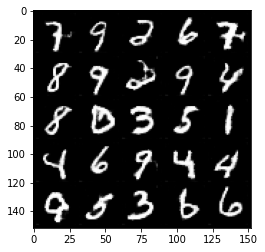

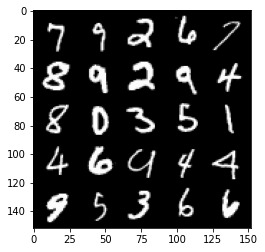

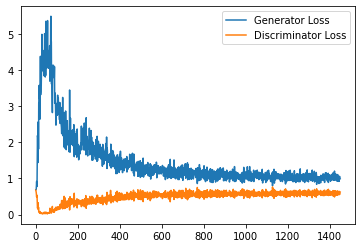

Step 29500: Generator loss: 1.0354145867824553, discriminator loss: 0.5988502171039581


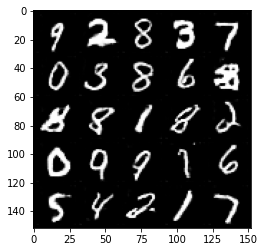

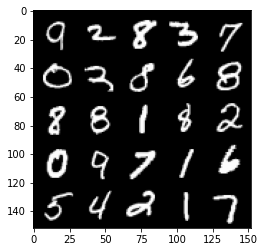

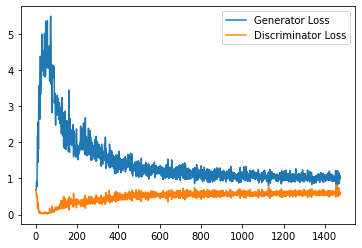

Step 30000: Generator loss: 1.0051087406873702, discriminator loss: 0.5937836326956749


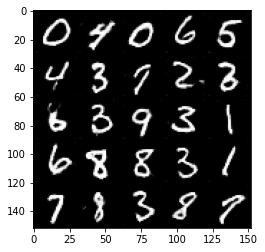

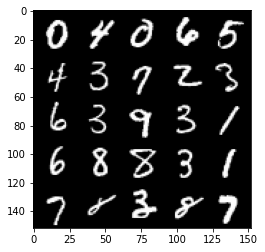

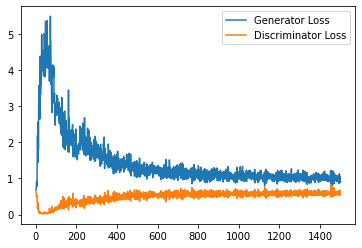

Step 30500: Generator loss: 1.0005107092857362, discriminator loss: 0.5903307778835296


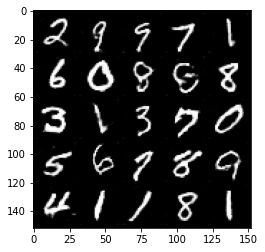

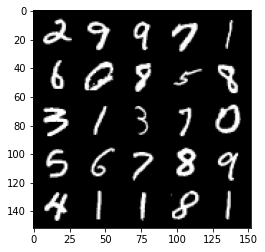

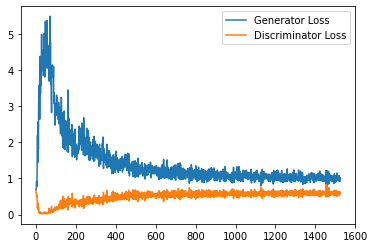

Step 31000: Generator loss: 1.0143164781332017, discriminator loss: 0.5870582419037819


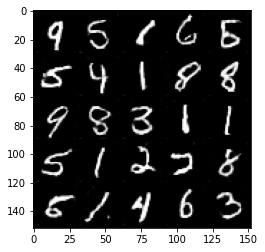

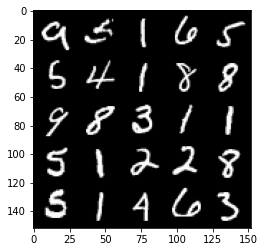

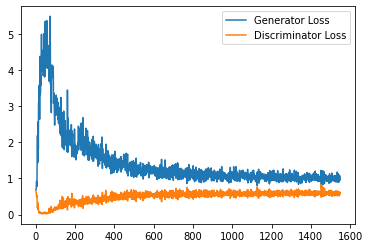

Step 31500: Generator loss: 1.0300060857534408, discriminator loss: 0.5921476868391037


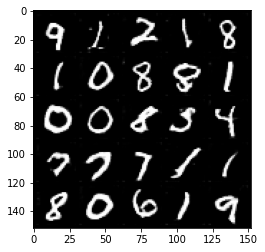

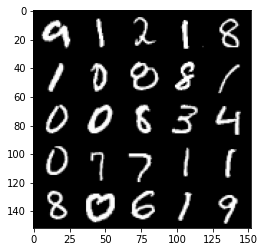

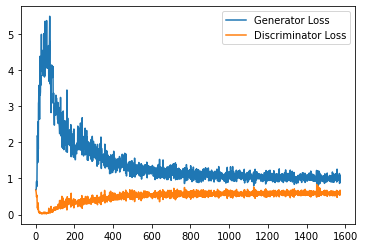

Step 32000: Generator loss: 1.008483144402504, discriminator loss: 0.5899130176901818


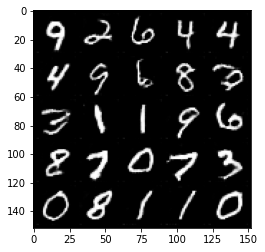

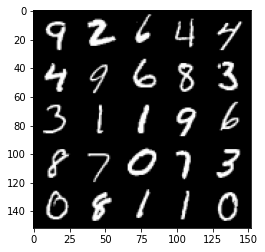

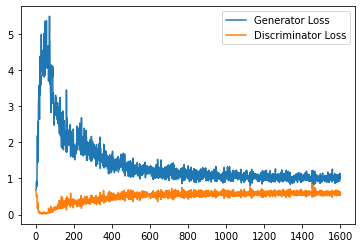

Step 32500: Generator loss: 1.0137633531093597, discriminator loss: 0.5922387018203735


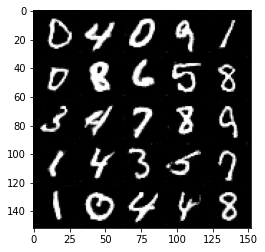

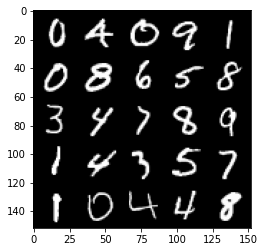

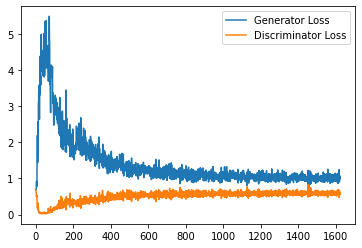

Step 33000: Generator loss: 1.0209498330354692, discriminator loss: 0.5998223723173142


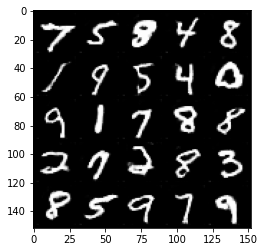

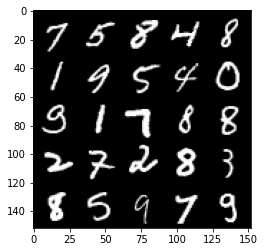

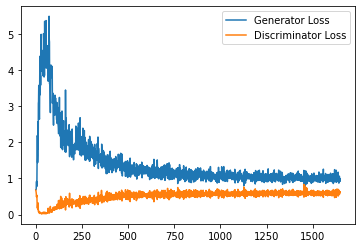

Step 33500: Generator loss: 0.9929503759145737, discriminator loss: 0.591439729988575


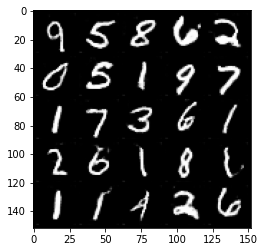

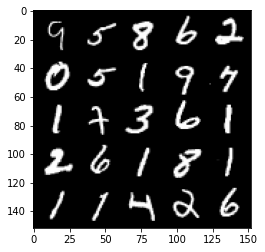

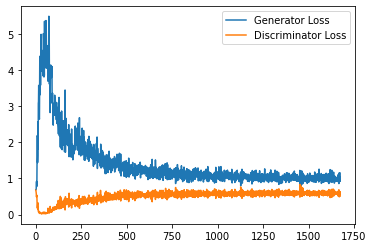

Step 34000: Generator loss: 1.0140939782857894, discriminator loss: 0.5985236485004425


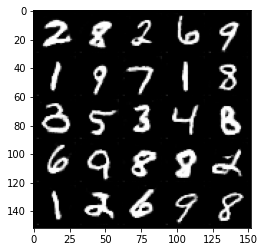

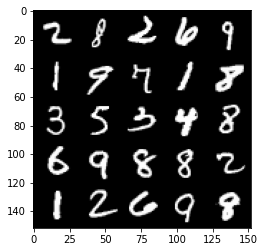

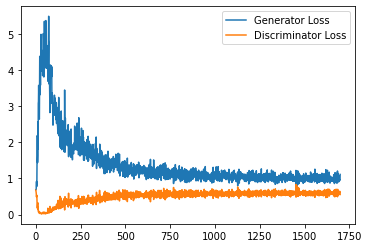

Step 34500: Generator loss: 1.0058511633872986, discriminator loss: 0.5944614767432213


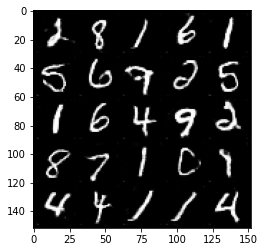

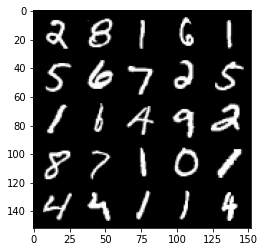

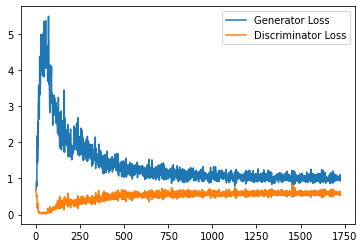

Step 35000: Generator loss: 1.0049707952737807, discriminator loss: 0.5960437738895417


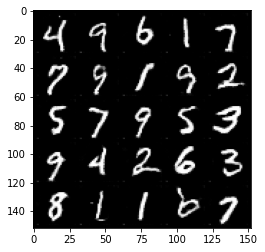

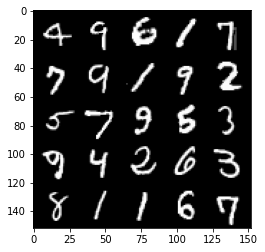

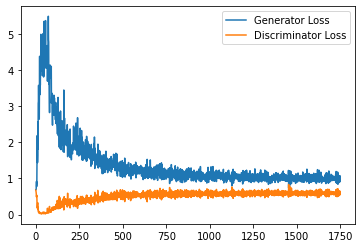

Step 35500: Generator loss: 0.9833888494968415, discriminator loss: 0.5916839725971222


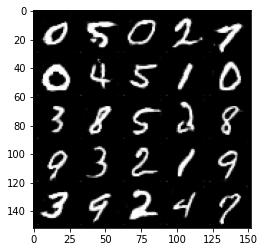

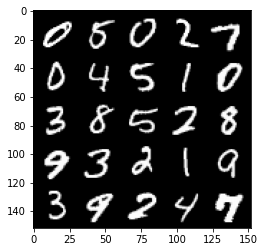

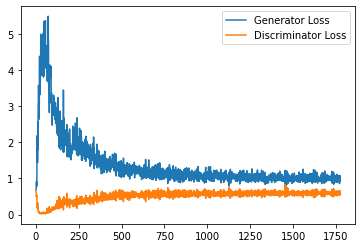

Step 36000: Generator loss: 1.0138914073705674, discriminator loss: 0.5906818684339523


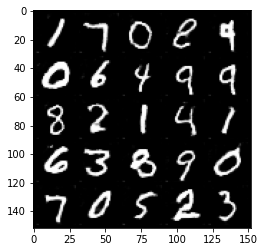

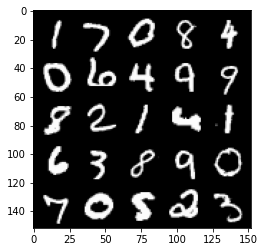

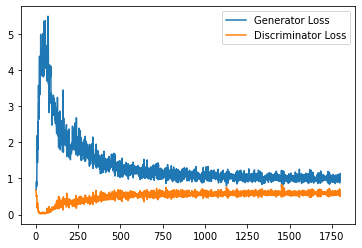

Step 36500: Generator loss: 1.0177970550060271, discriminator loss: 0.5903532148599625


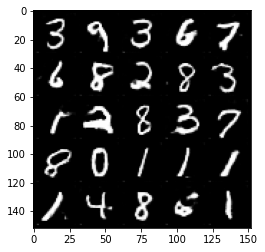

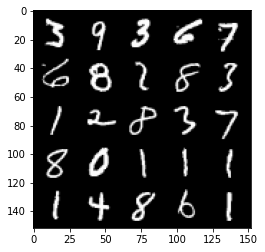

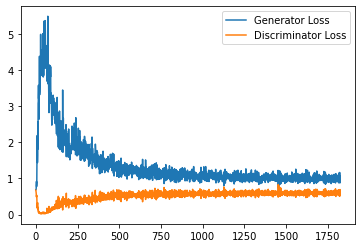

Step 37000: Generator loss: 0.994169713139534, discriminator loss: 0.5926964048743248


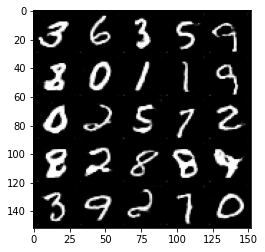

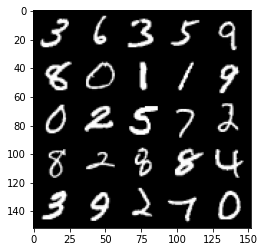

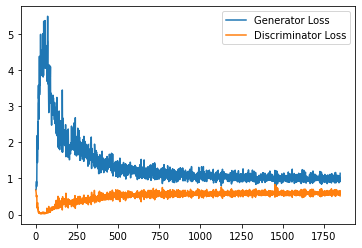

Step 37500: Generator loss: 1.0002138741016389, discriminator loss: 0.5942339355349541


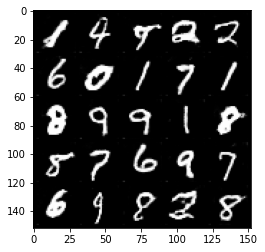

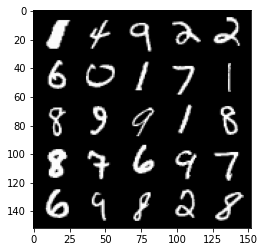

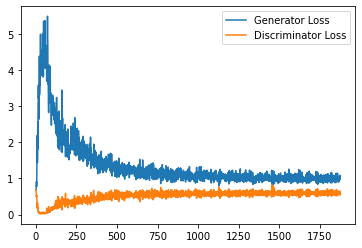

Step 38000: Generator loss: 1.0187421181201934, discriminator loss: 0.5941198362112046


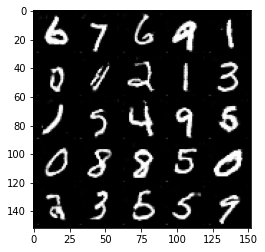

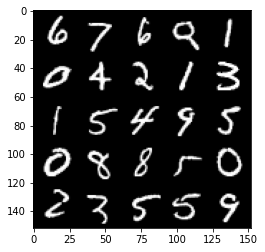

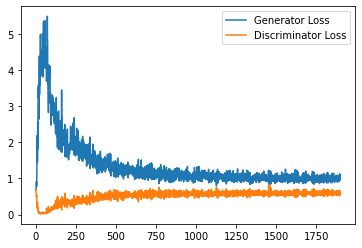

Step 38500: Generator loss: 1.0250568965673446, discriminator loss: 0.592492529451847


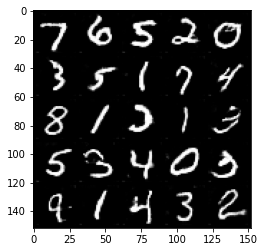

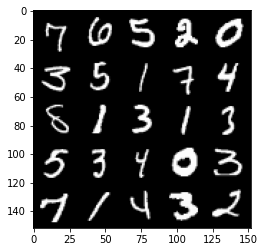

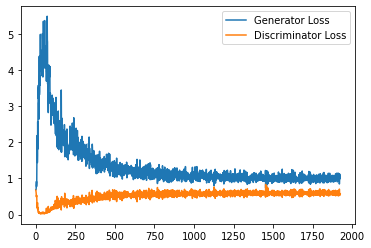

Step 39000: Generator loss: 0.9991172032356263, discriminator loss: 0.59230064868927


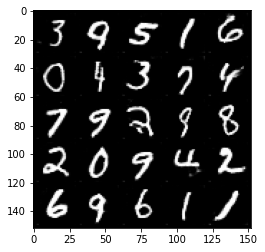

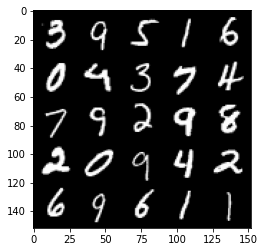

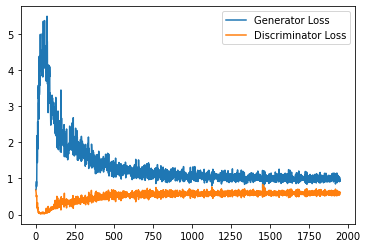

Step 39500: Generator loss: 1.0019164652824402, discriminator loss: 0.5922805199027061


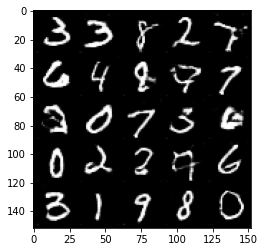

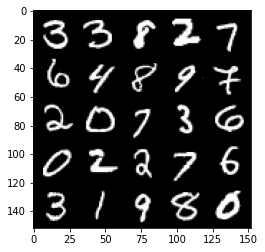

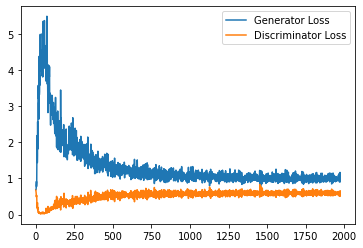

Step 40000: Generator loss: 1.0010989508628845, discriminator loss: 0.5973615282773972


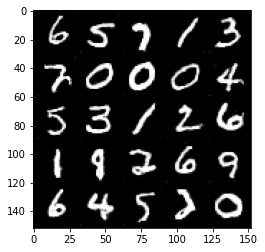

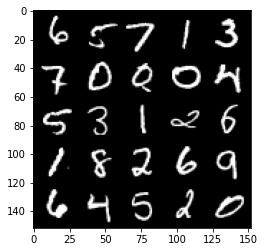

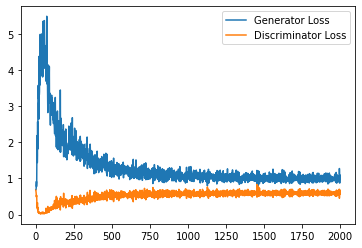

Step 40500: Generator loss: 0.9938609244823455, discriminator loss: 0.5949588144421577


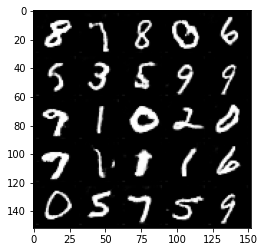

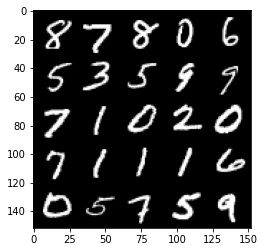

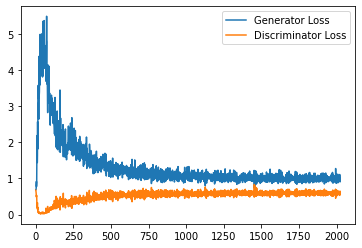

Step 41000: Generator loss: 0.9848748700618744, discriminator loss: 0.5934679391980171


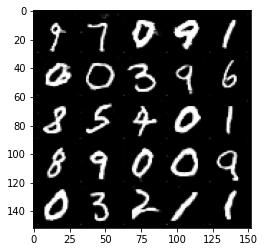

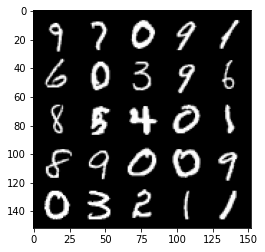

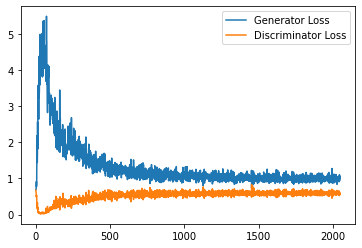

Step 41500: Generator loss: 1.0010682017803192, discriminator loss: 0.5961175547838211


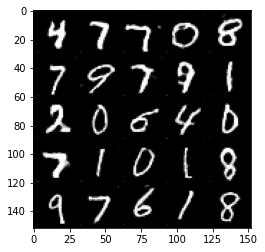

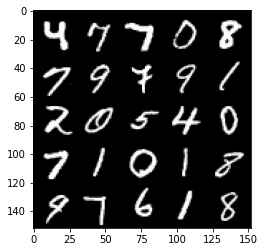

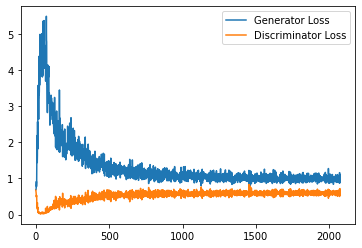

Step 42000: Generator loss: 1.0297457959651948, discriminator loss: 0.5900199027061462


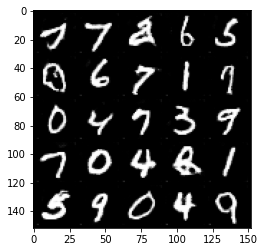

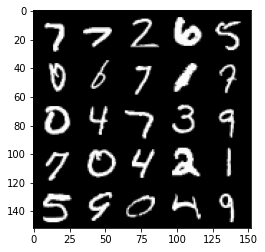

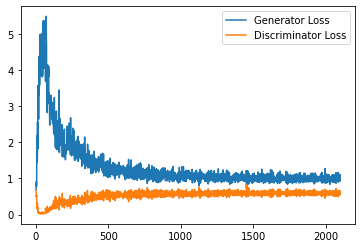

Step 42500: Generator loss: 1.012308201313019, discriminator loss: 0.5926803914904595


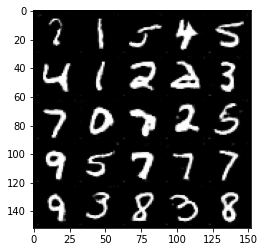

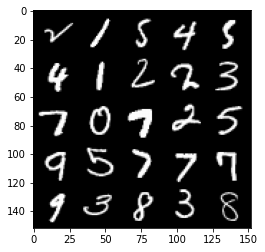

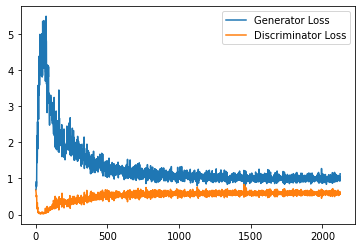

Step 43000: Generator loss: 1.0068832108974457, discriminator loss: 0.5943132513165474


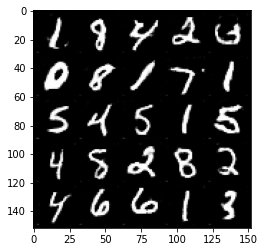

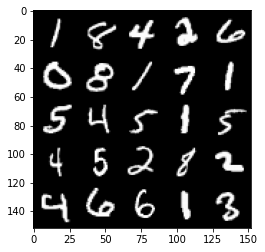

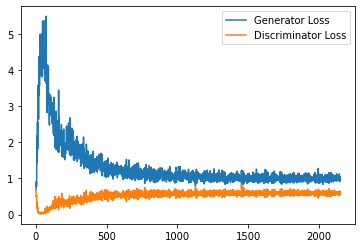

Step 43500: Generator loss: 0.9944622336626053, discriminator loss: 0.5906943623423576


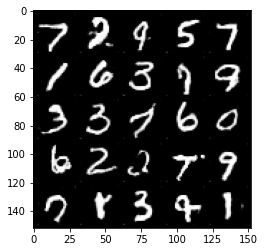

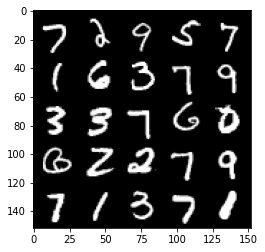

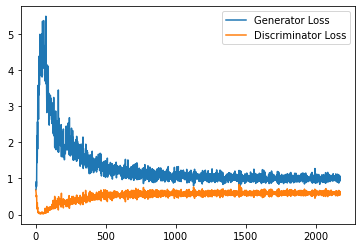

Step 44000: Generator loss: 0.9747791823148727, discriminator loss: 0.5987287845015525


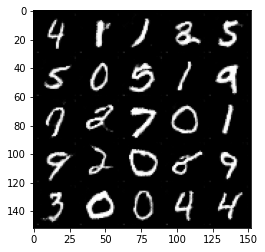

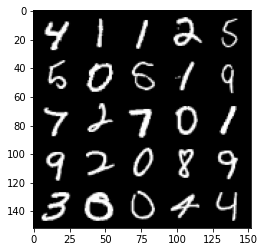

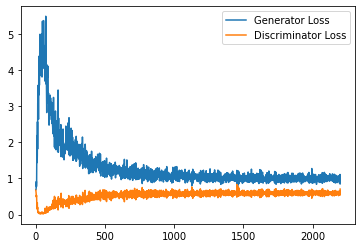

Step 44500: Generator loss: 1.0216713515520095, discriminator loss: 0.584729139149189


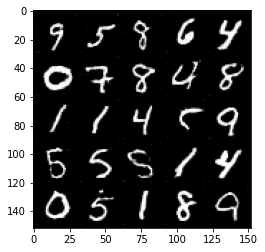

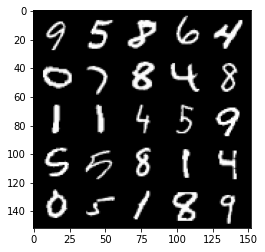

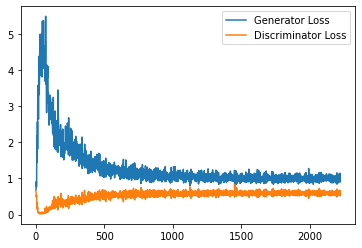

Step 45000: Generator loss: 0.9996026329994202, discriminator loss: 0.5948786140680313


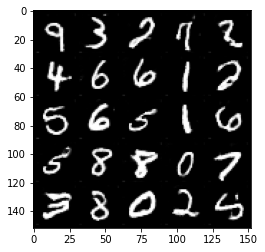

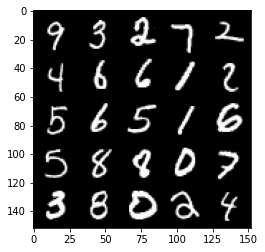

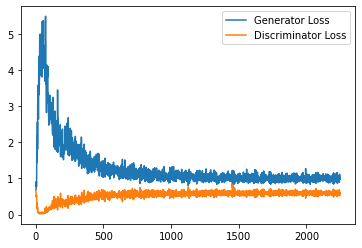

Step 45500: Generator loss: 1.0137854895591736, discriminator loss: 0.5936015692949295


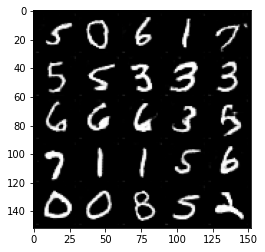

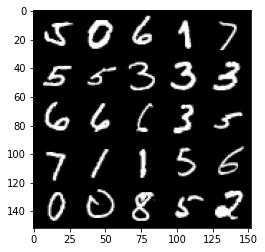

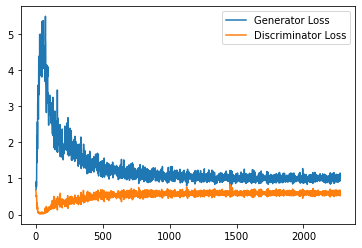

Step 46000: Generator loss: 1.022152938246727, discriminator loss: 0.5890255525112152


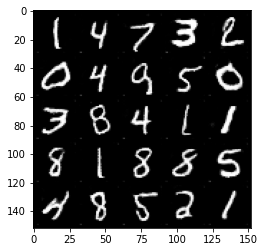

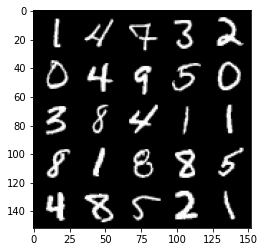

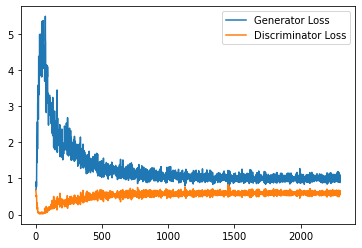

Step 46500: Generator loss: 1.0284117013216019, discriminator loss: 0.586083375453949


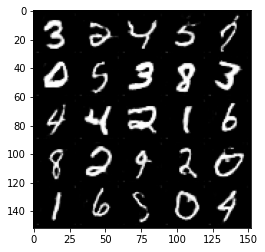

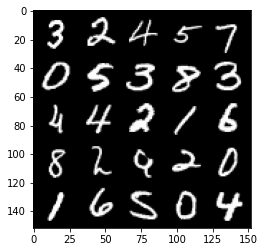

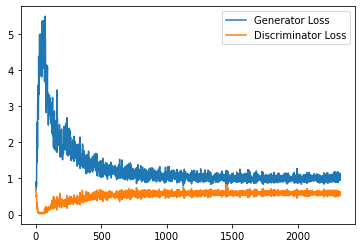

Step 47000: Generator loss: 0.9826429926156998, discriminator loss: 0.5925873380899429


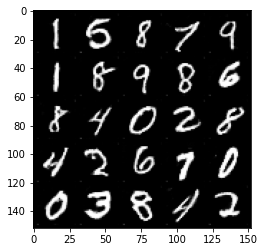

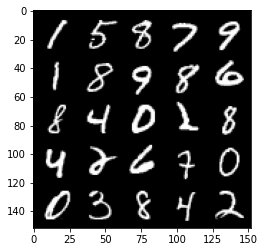

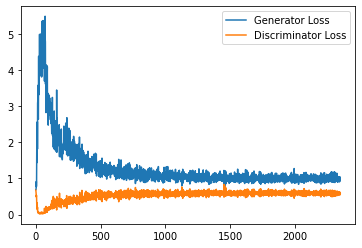

Step 47500: Generator loss: 1.0047812576293946, discriminator loss: 0.5903886462450028


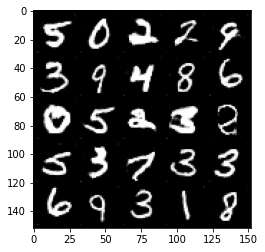

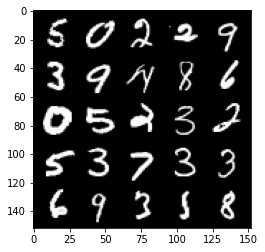

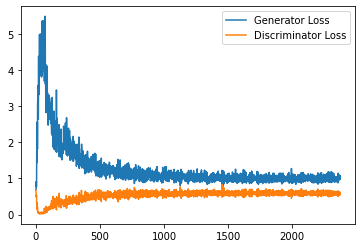

Step 48000: Generator loss: 1.008218224644661, discriminator loss: 0.5902131146788597


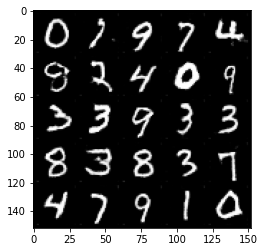

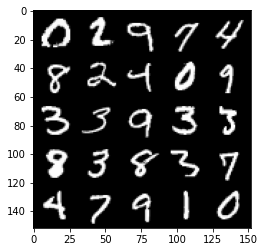

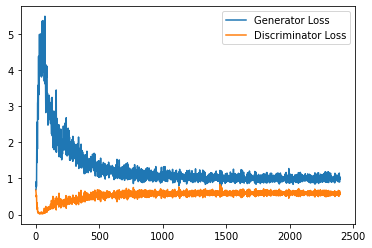

Step 48500: Generator loss: 1.023597156047821, discriminator loss: 0.5897144995927811


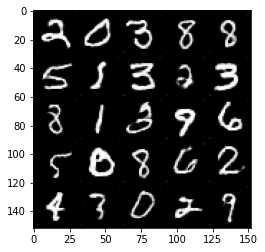

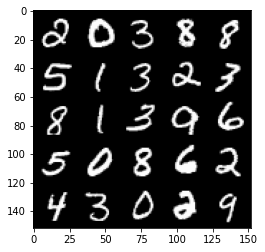

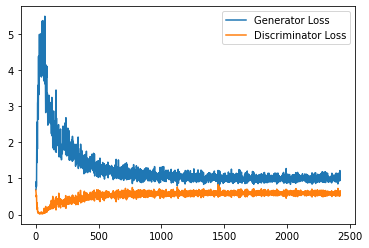

Step 49000: Generator loss: 1.008015599012375, discriminator loss: 0.5883542532324791


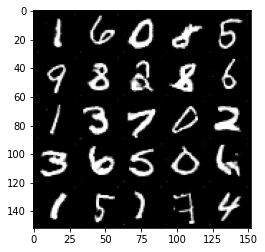

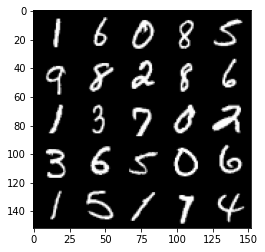

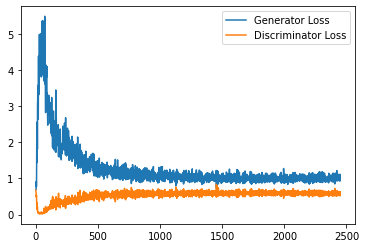

Step 49500: Generator loss: 1.0529514685869217, discriminator loss: 0.5891448646187782


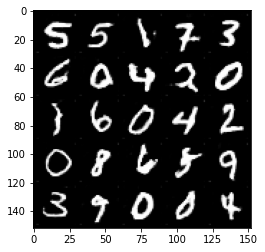

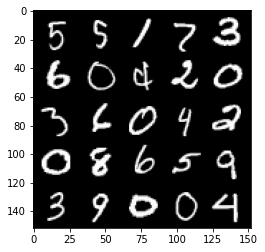

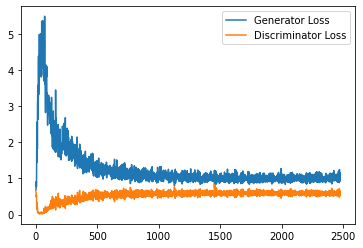

Step 50000: Generator loss: 1.0270197969675063, discriminator loss: 0.5922487125992775


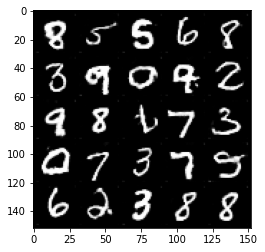

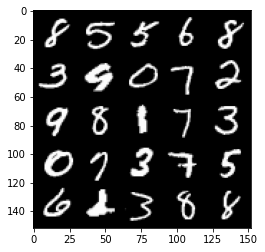

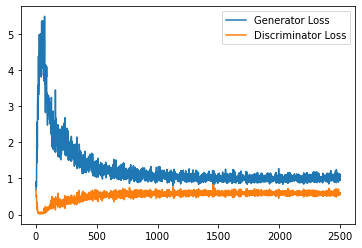

Step 50500: Generator loss: 1.005309886932373, discriminator loss: 0.5855863426327705


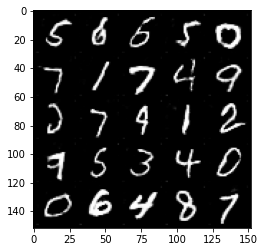

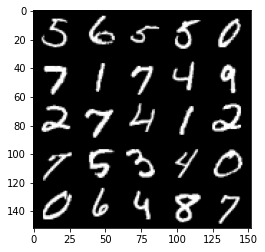

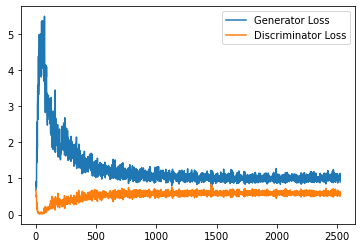

Step 51000: Generator loss: 1.0154439001083373, discriminator loss: 0.5885249538421631


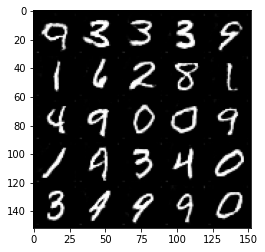

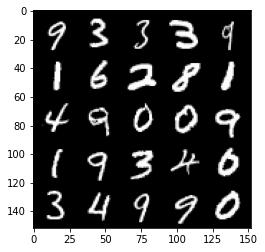

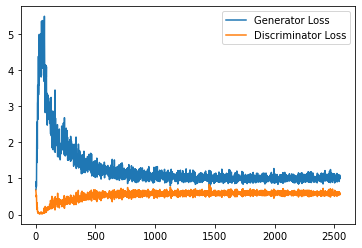

Step 51500: Generator loss: 1.0104030455350876, discriminator loss: 0.5859075558185577


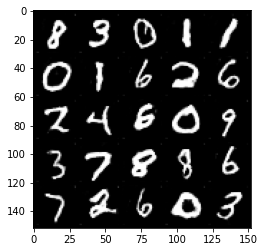

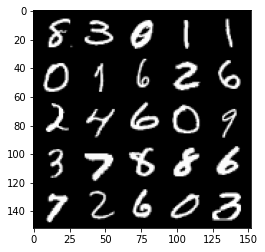

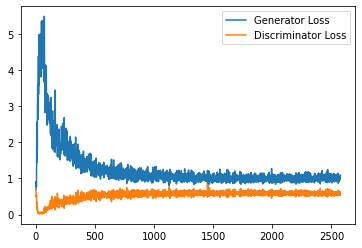

Step 52000: Generator loss: 1.0395429258346558, discriminator loss: 0.5888759204149246


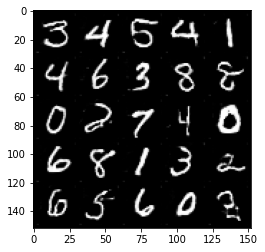

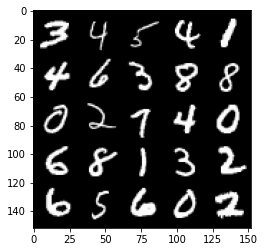

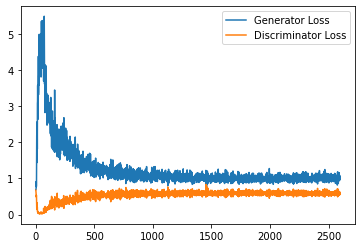

Step 52500: Generator loss: 1.0099251450300217, discriminator loss: 0.578633370757103


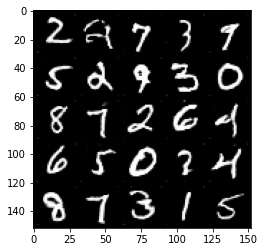

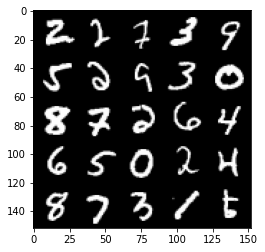

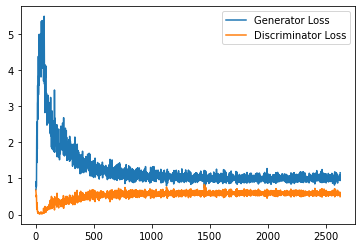

Step 53000: Generator loss: 1.0187155032157897, discriminator loss: 0.590624486386776


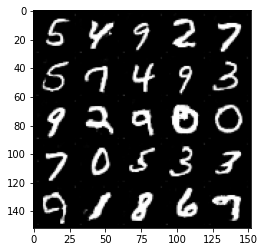

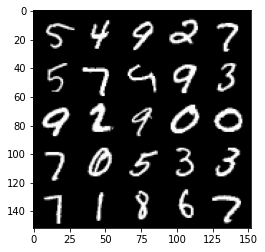

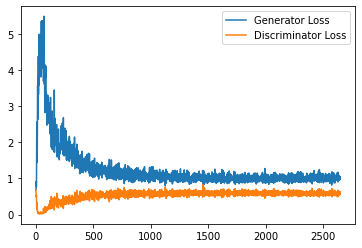

Step 53500: Generator loss: 1.0258061199188233, discriminator loss: 0.5813123853802681


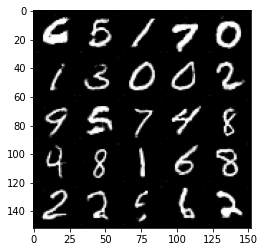

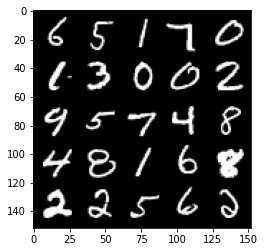

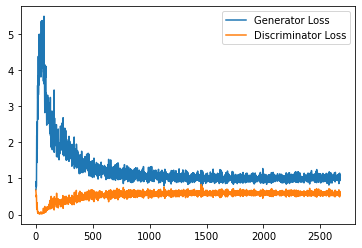

Step 54000: Generator loss: 1.0269041032791137, discriminator loss: 0.580355156481266


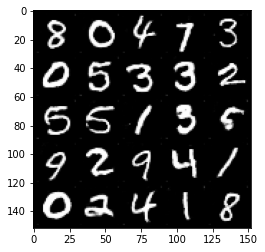

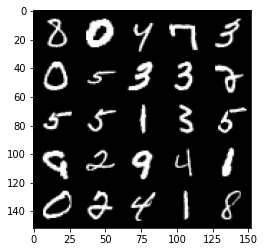

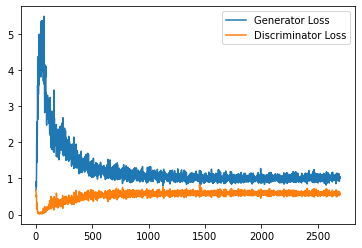

Step 54500: Generator loss: 1.0404477578401565, discriminator loss: 0.581568651497364


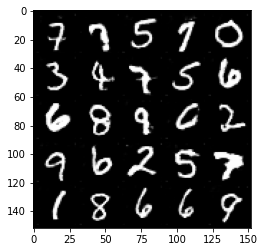

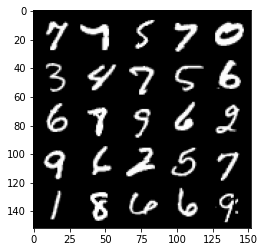

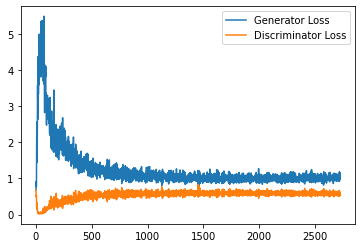

Step 55000: Generator loss: 1.0558940848112106, discriminator loss: 0.5845957690477371


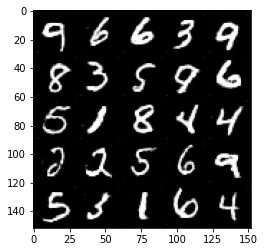

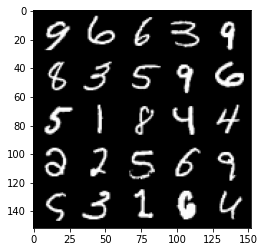

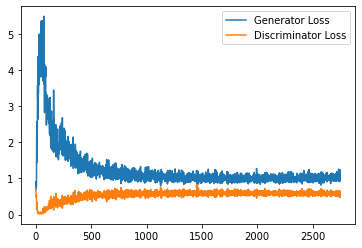

Step 55500: Generator loss: 1.034735484957695, discriminator loss: 0.5800418459773063


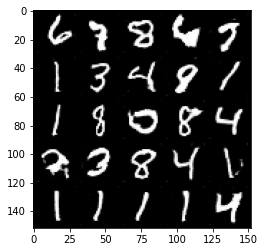

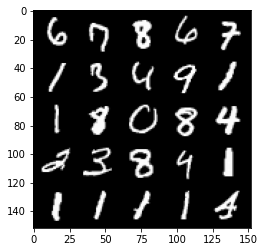

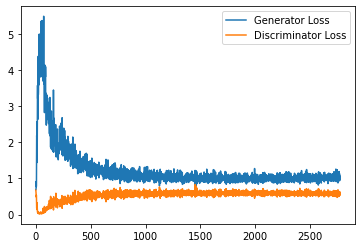

Step 56000: Generator loss: 1.0224633479118348, discriminator loss: 0.5825459302663804


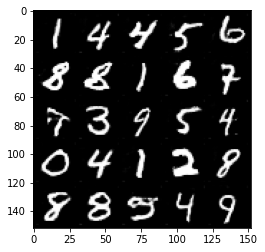

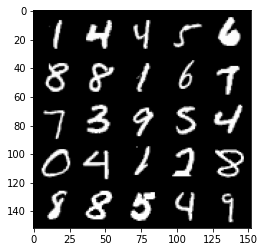

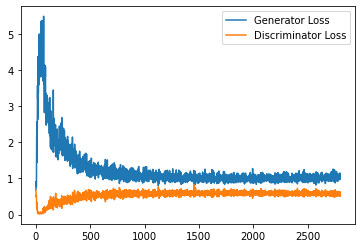

Step 56500: Generator loss: 1.0390093957185744, discriminator loss: 0.5816944511532783


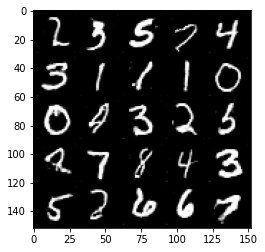

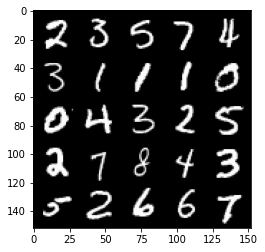

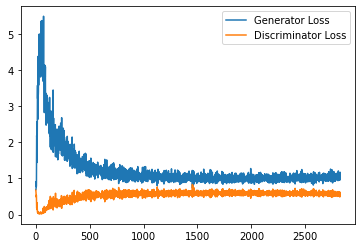

Step 57000: Generator loss: 1.0259237506389618, discriminator loss: 0.5795140700936318


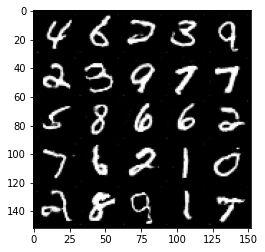

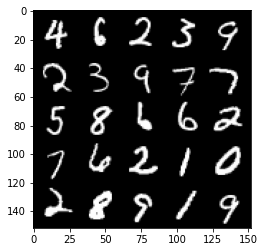

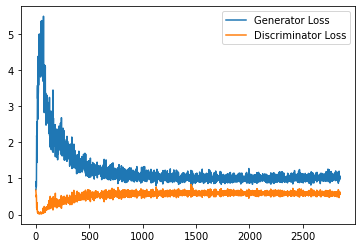

Step 57500: Generator loss: 1.0105476820468902, discriminator loss: 0.582492708325386


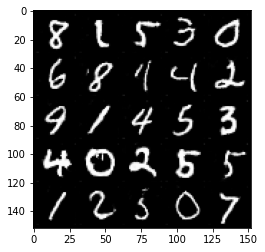

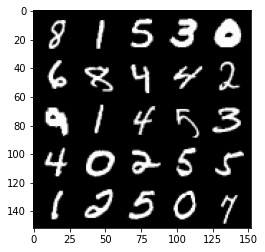

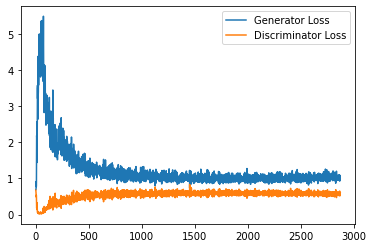

Step 58000: Generator loss: 1.0364145529270172, discriminator loss: 0.5798374021053314


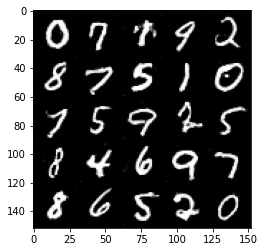

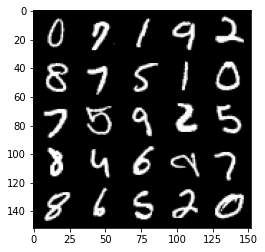

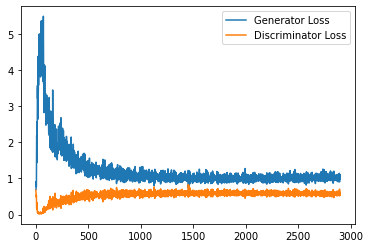

Step 58500: Generator loss: 1.02969273519516, discriminator loss: 0.5826819552779198


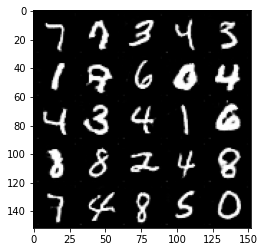

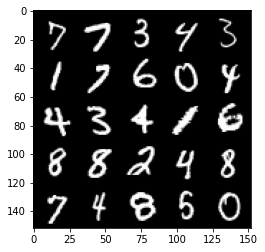

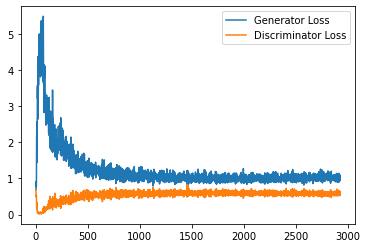

Step 59000: Generator loss: 1.0451450480222702, discriminator loss: 0.5775328513383865


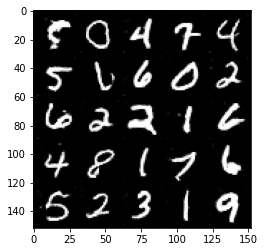

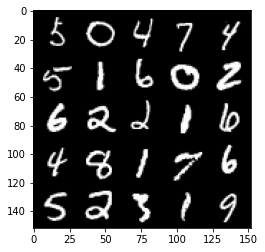

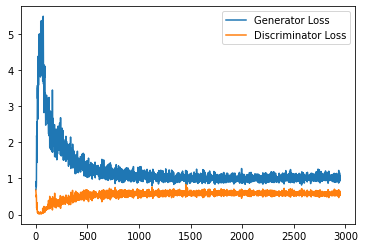

Step 59500: Generator loss: 1.0304845269918441, discriminator loss: 0.5786961042284966


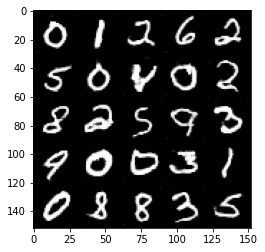

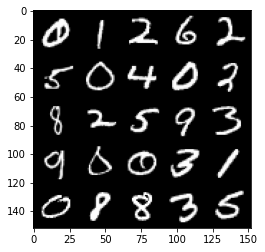

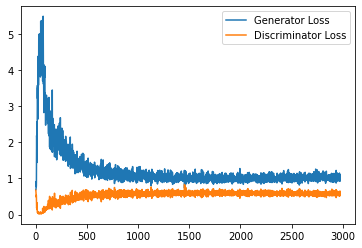

Step 60000: Generator loss: 1.0443873387575149, discriminator loss: 0.5759587050080299


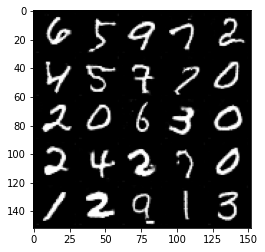

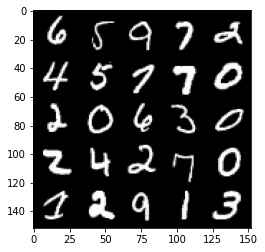

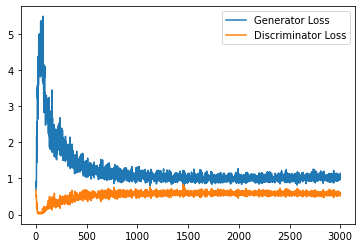

Step 60500: Generator loss: 1.0392562282085418, discriminator loss: 0.5843464439511299


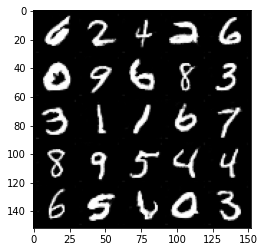

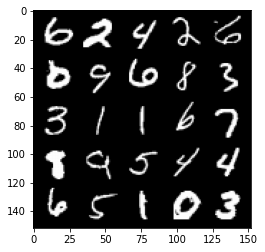

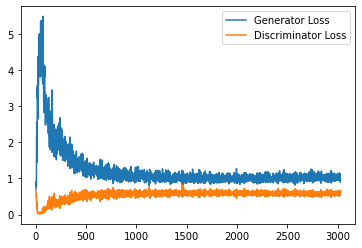

Step 61000: Generator loss: 1.0306745388507843, discriminator loss: 0.5787886725068092


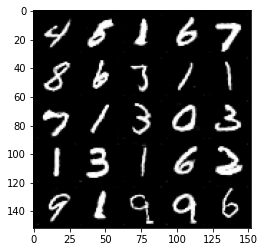

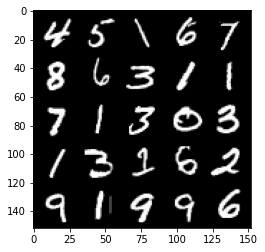

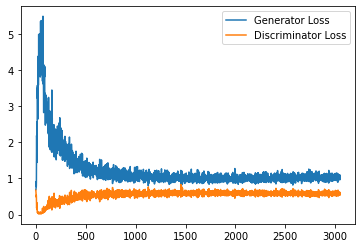

Step 61500: Generator loss: 1.0428423969745635, discriminator loss: 0.5733399829864502


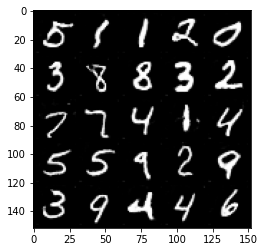

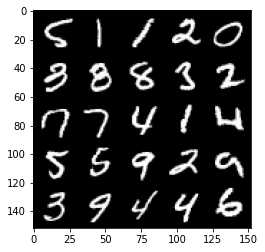

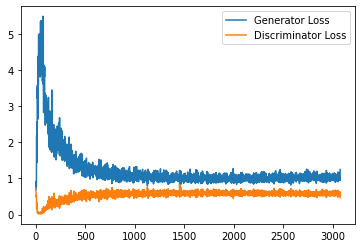

Step 62000: Generator loss: 1.032596398472786, discriminator loss: 0.5782905068397522


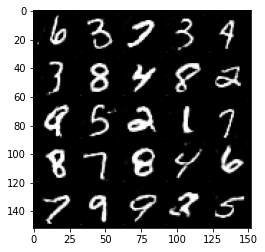

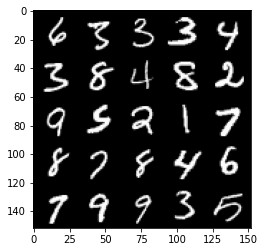

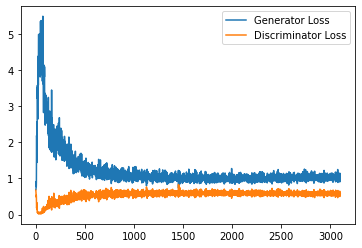

Step 62500: Generator loss: 1.0456339005231858, discriminator loss: 0.5741300131082535


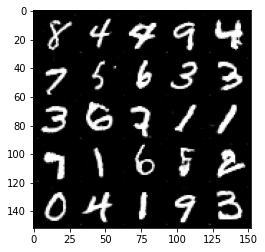

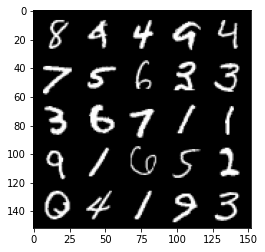

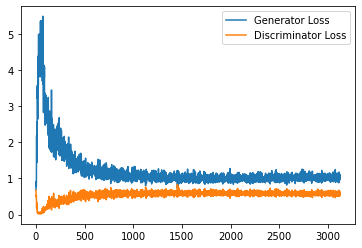

Step 63000: Generator loss: 1.0471623377799988, discriminator loss: 0.5781469540596008


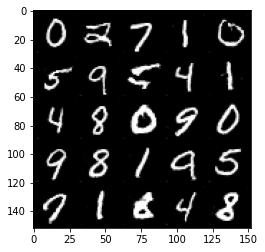

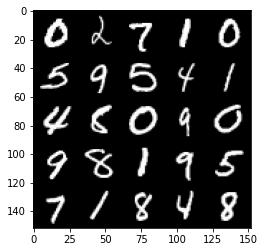

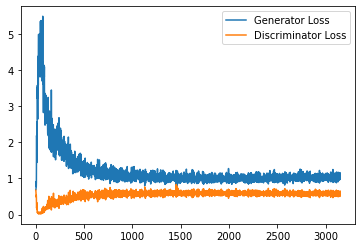

Step 63500: Generator loss: 1.0470225182771682, discriminator loss: 0.5749421669244766


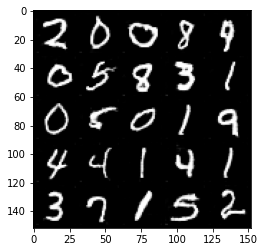

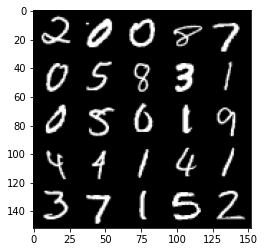

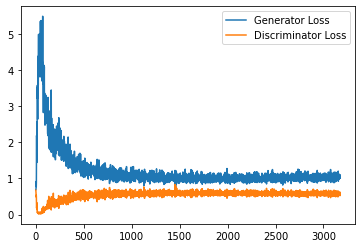

Step 64000: Generator loss: 1.0490384485721589, discriminator loss: 0.5757606147527695


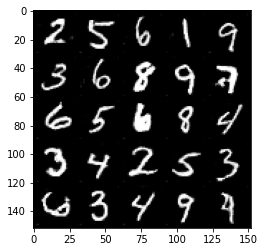

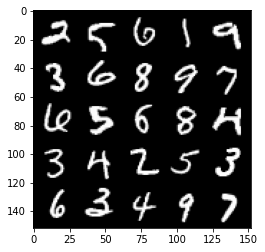

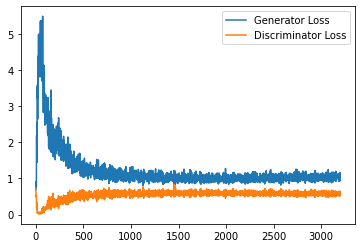

Step 64500: Generator loss: 1.0574992833137513, discriminator loss: 0.5775812246203422


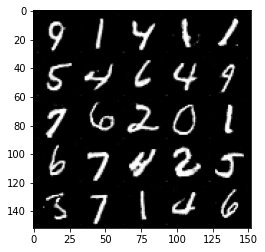

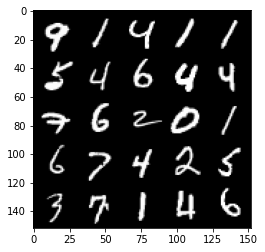

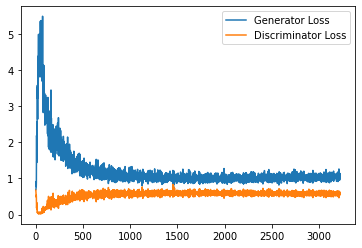

Step 65000: Generator loss: 1.0466531455516814, discriminator loss: 0.5724071276783943


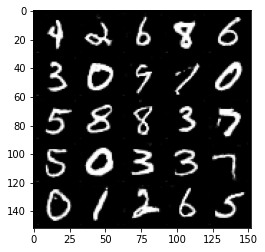

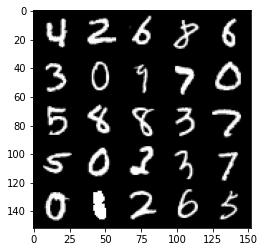

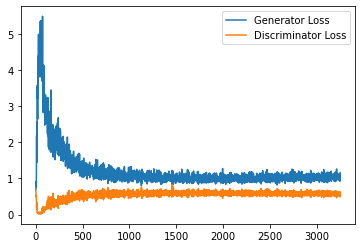

Step 65500: Generator loss: 1.0332929179668426, discriminator loss: 0.5816128995418549


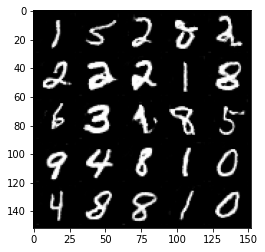

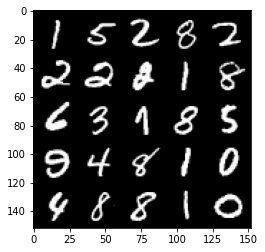

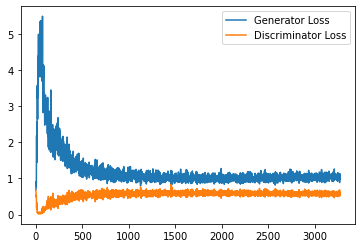

Step 66000: Generator loss: 1.0532826470136643, discriminator loss: 0.5730881134867668


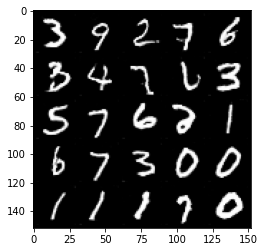

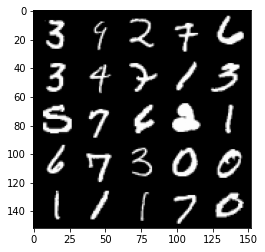

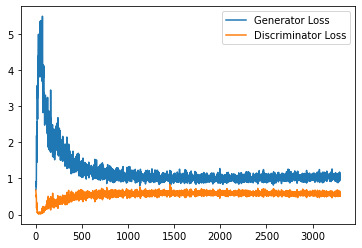

Step 66500: Generator loss: 1.045060024023056, discriminator loss: 0.5761763343811035


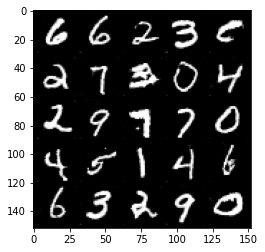

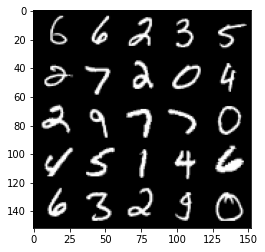

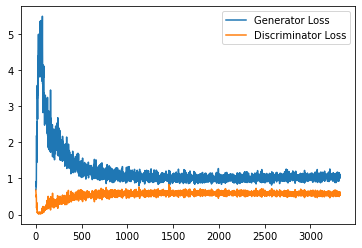

Step 67000: Generator loss: 1.074476090669632, discriminator loss: 0.5772043913602829


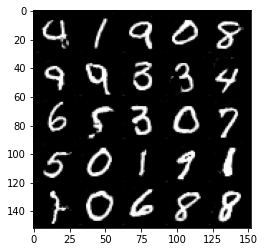

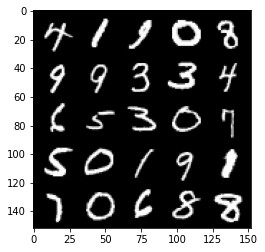

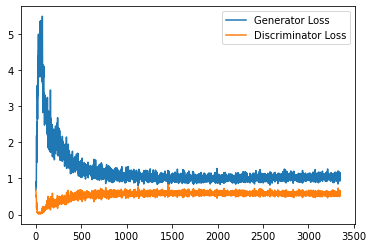

Step 67500: Generator loss: 1.0497002421617507, discriminator loss: 0.5809937199950218


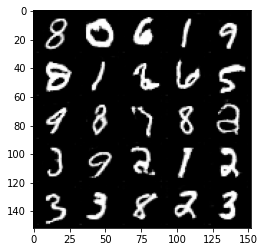

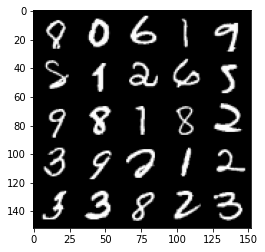

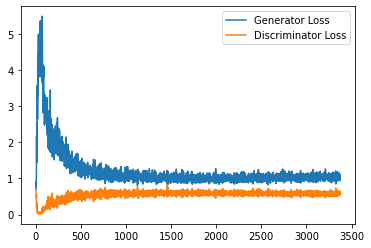

Step 68000: Generator loss: 1.0648778674602508, discriminator loss: 0.5708343476057053


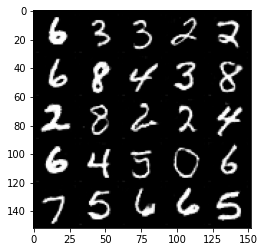

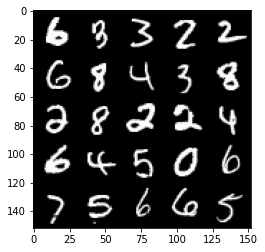

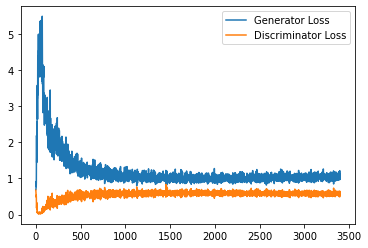

Step 68500: Generator loss: 1.0497585722208023, discriminator loss: 0.5781212584376335


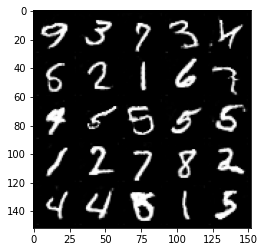

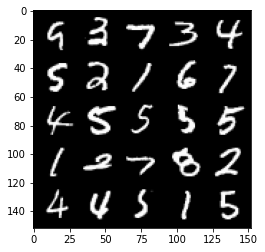

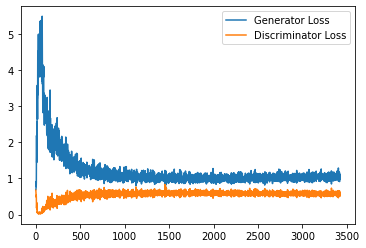

Step 69000: Generator loss: 1.0405113691091536, discriminator loss: 0.5804499747157097


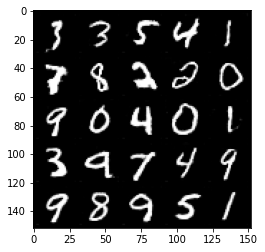

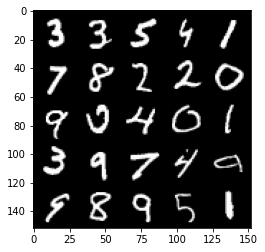

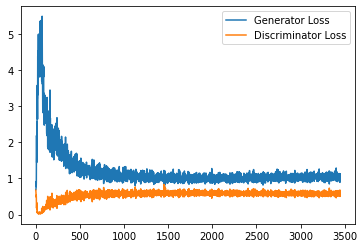

Step 69500: Generator loss: 1.0431634746789933, discriminator loss: 0.5779341710805893


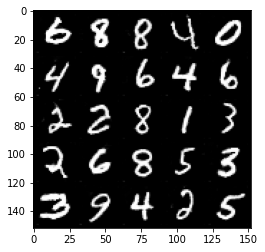

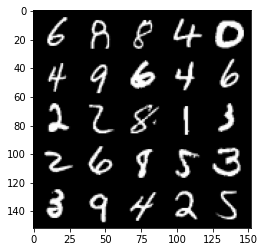

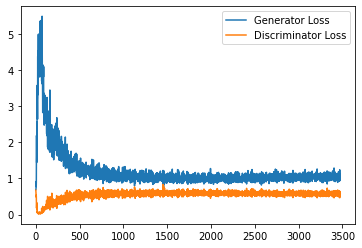

Step 70000: Generator loss: 1.075715777873993, discriminator loss: 0.5802124827504158


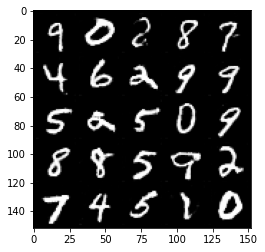

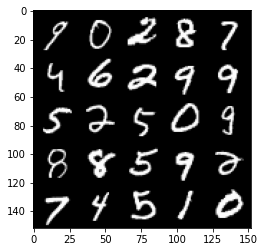

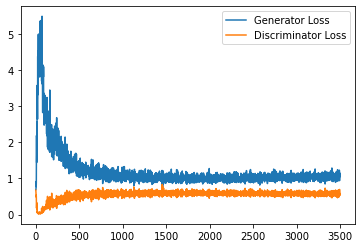

Step 70500: Generator loss: 1.0584410766363144, discriminator loss: 0.5841054369211197


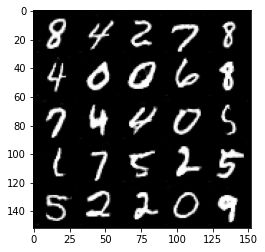

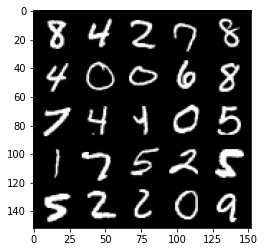

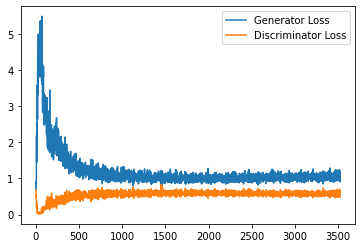

Step 71000: Generator loss: 1.0428478572368622, discriminator loss: 0.5809693161845207


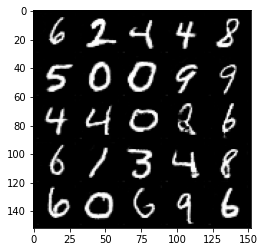

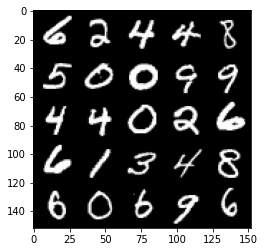

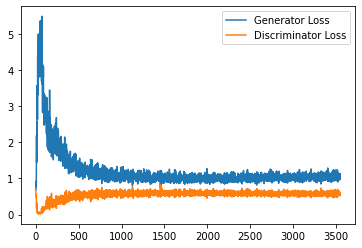

Step 71500: Generator loss: 1.0486570234298707, discriminator loss: 0.5823606167435647


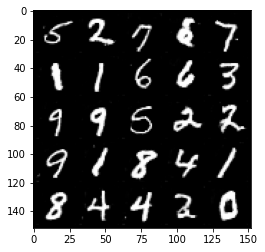

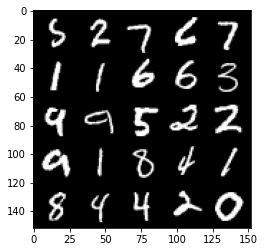

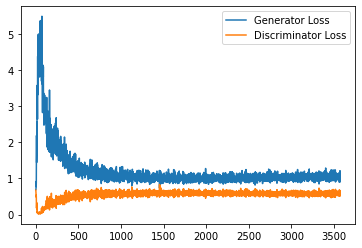

Step 72000: Generator loss: 1.0593917664289474, discriminator loss: 0.5852022015452385


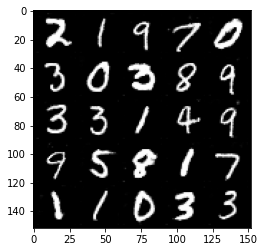

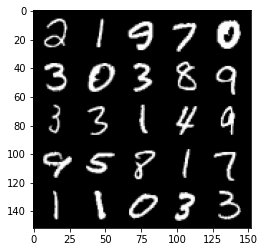

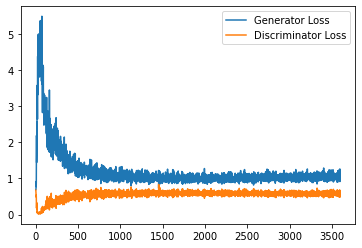

Step 72500: Generator loss: 1.0570389431715013, discriminator loss: 0.577518165409565


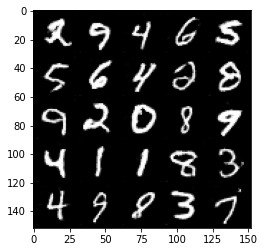

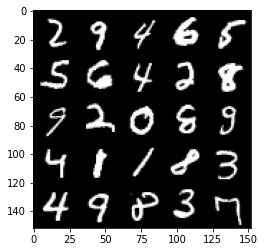

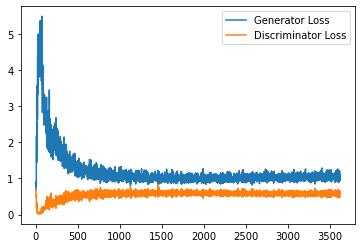

Step 73000: Generator loss: 1.0449489421844482, discriminator loss: 0.5841052005290985


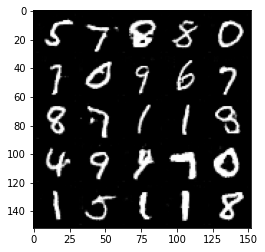

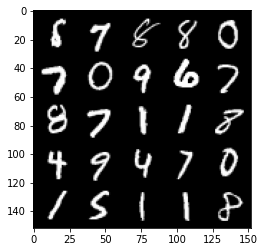

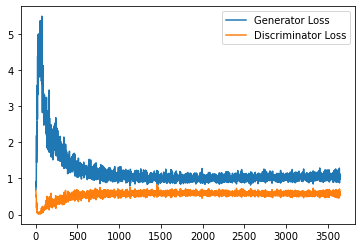

Step 73500: Generator loss: 1.037637896180153, discriminator loss: 0.5802126671671868


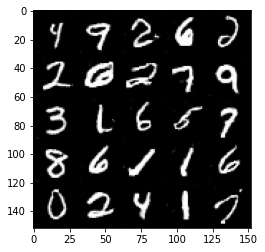

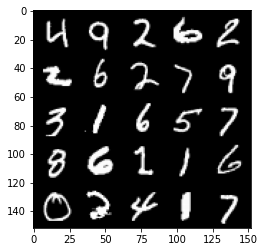

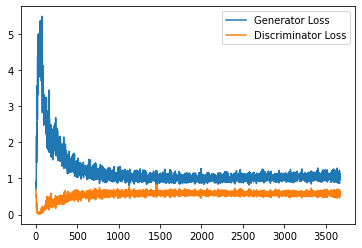

Step 74000: Generator loss: 1.0483542033433915, discriminator loss: 0.575810200035572


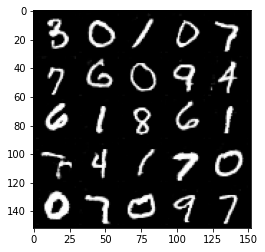

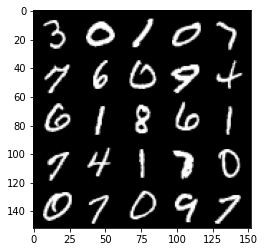

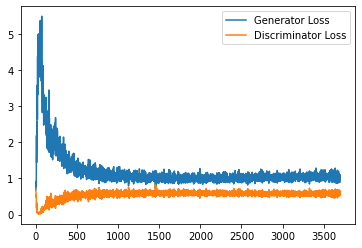

Step 74500: Generator loss: 1.0556062713861465, discriminator loss: 0.5848999880552291


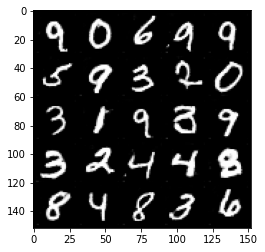

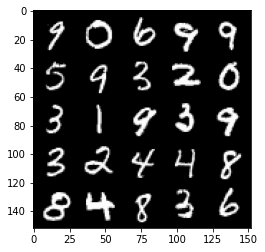

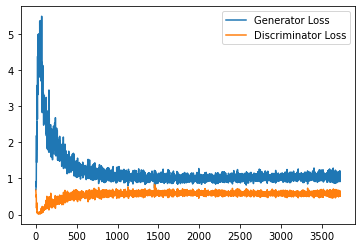

Step 75000: Generator loss: 1.0395154052972793, discriminator loss: 0.5793637512326241


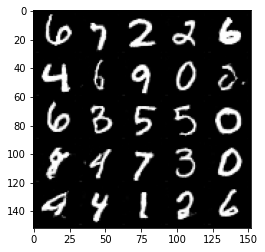

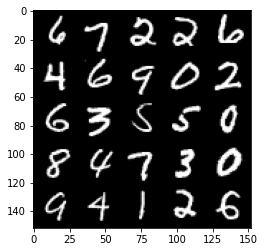

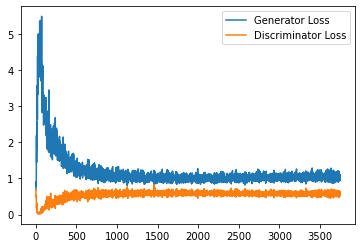

Step 75500: Generator loss: 1.0428574018478394, discriminator loss: 0.5827513105869293


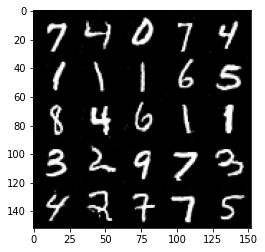

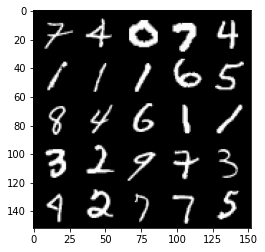

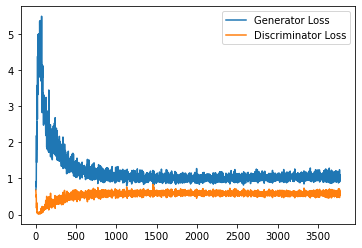

Step 76000: Generator loss: 1.0610343376398086, discriminator loss: 0.5788112057447433


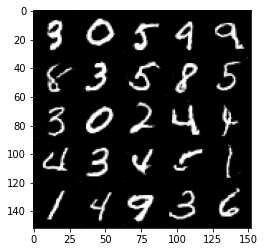

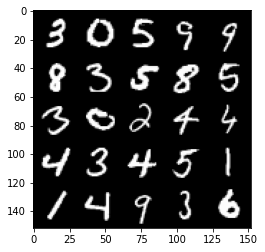

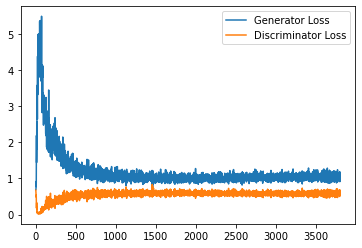

Step 76500: Generator loss: 1.049043601512909, discriminator loss: 0.5828554190397263


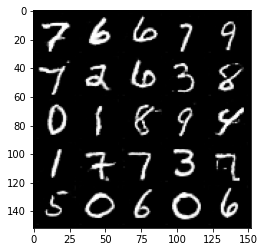

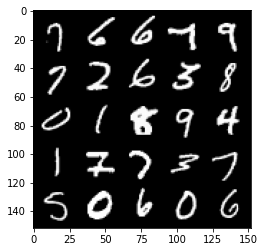

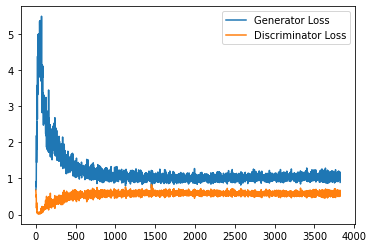

Step 77000: Generator loss: 1.0560001611709595, discriminator loss: 0.581412447988987


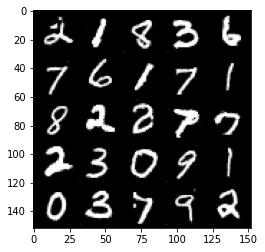

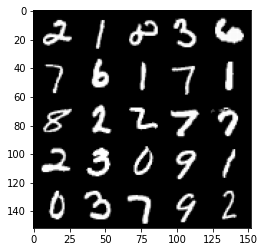

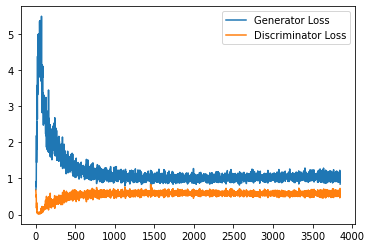

Step 77500: Generator loss: 1.0592075246572494, discriminator loss: 0.5754595069885254


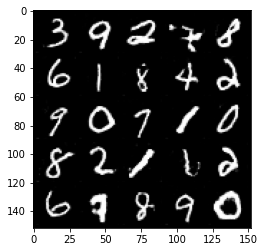

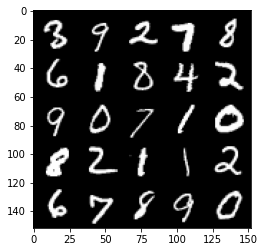

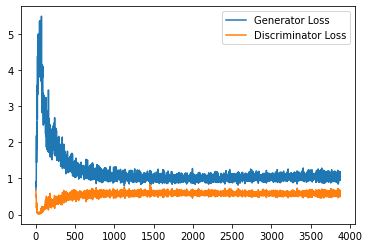

Step 78000: Generator loss: 1.0605612015724182, discriminator loss: 0.5798934114575386


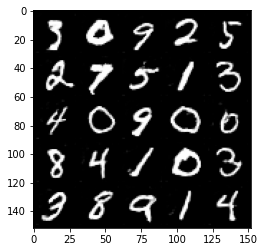

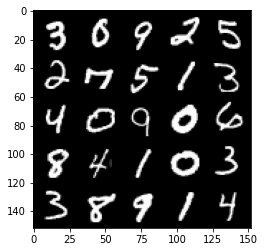

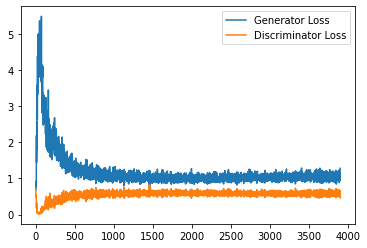

Step 78500: Generator loss: 1.0427163203954697, discriminator loss: 0.5822938473820687


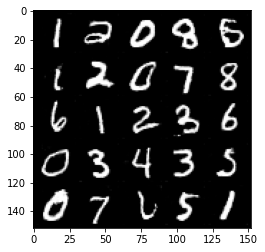

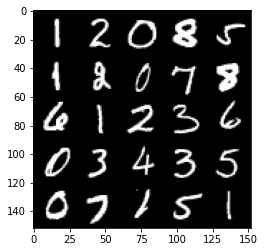

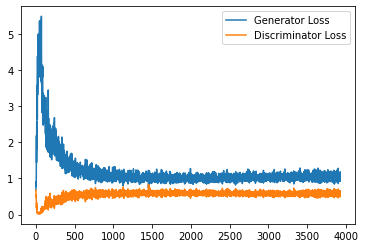

Step 79000: Generator loss: 1.0455386093854904, discriminator loss: 0.5767188590168953


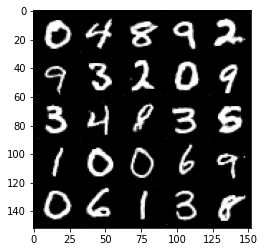

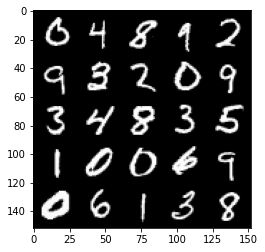

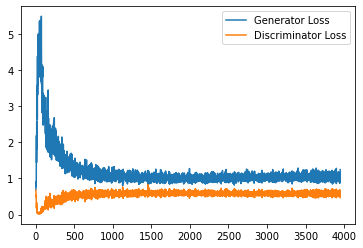

Step 79500: Generator loss: 1.0574620699882507, discriminator loss: 0.5858412099480629


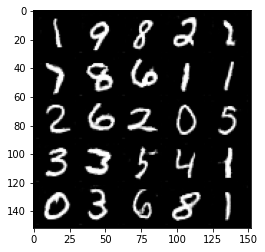

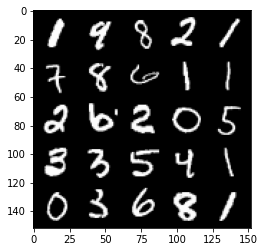

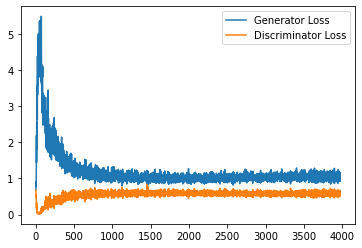

Step 80000: Generator loss: 1.068493064880371, discriminator loss: 0.5800902789235115


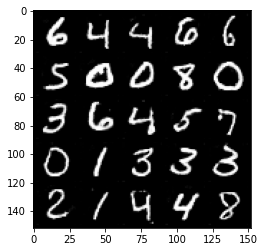

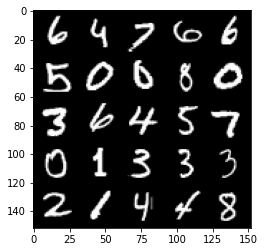

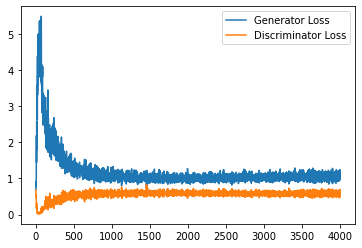

Step 80500: Generator loss: 1.0516053483486176, discriminator loss: 0.5828233287334442


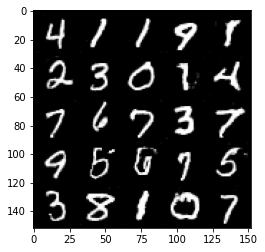

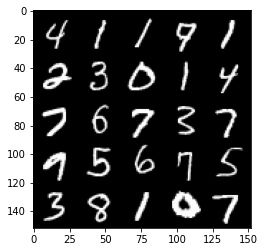

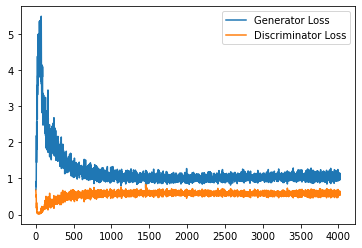

Step 81000: Generator loss: 1.0564572600126267, discriminator loss: 0.5829008984565734


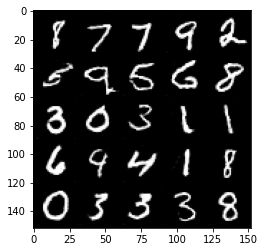

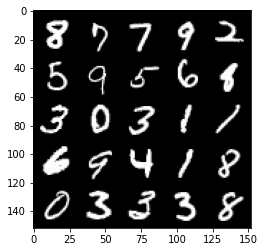

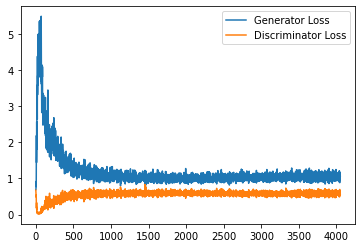

Step 81500: Generator loss: 1.0464723924398422, discriminator loss: 0.5827206405997276


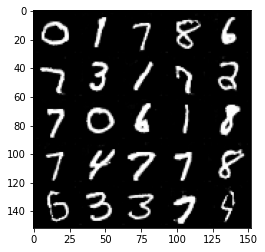

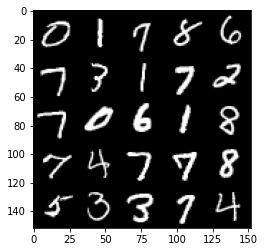

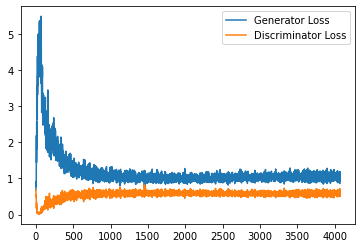

Step 82000: Generator loss: 1.0621291425228119, discriminator loss: 0.5825735756158829


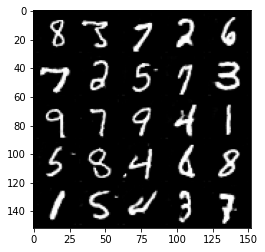

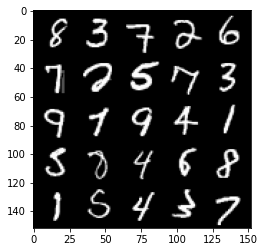

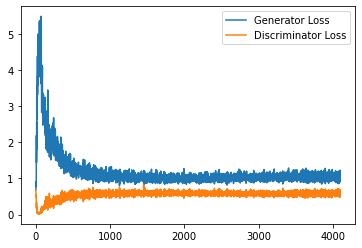

Step 82500: Generator loss: 1.0657167062759398, discriminator loss: 0.5866325326561928


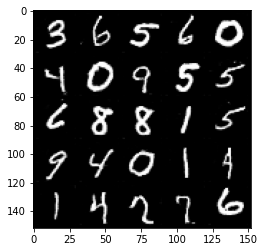

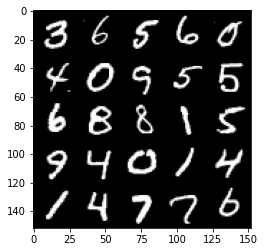

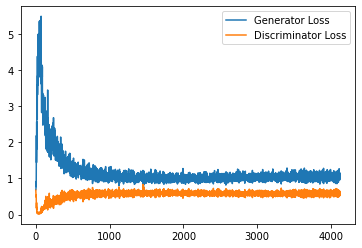

Step 83000: Generator loss: 1.0465642776489257, discriminator loss: 0.5879689500927925


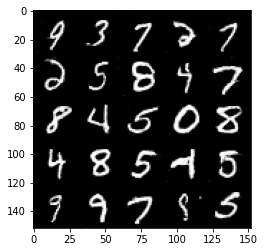

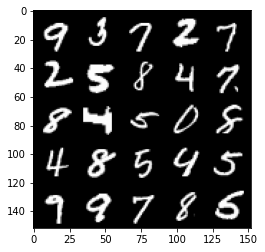

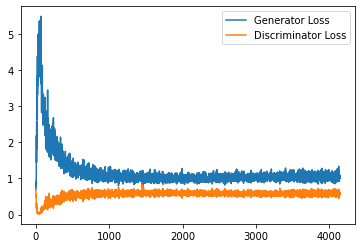

Step 83500: Generator loss: 1.0361214240789414, discriminator loss: 0.5866928187608719


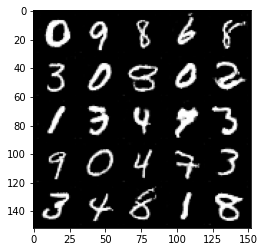

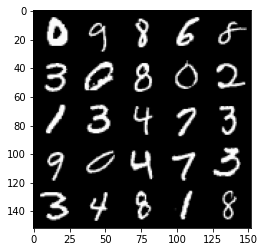

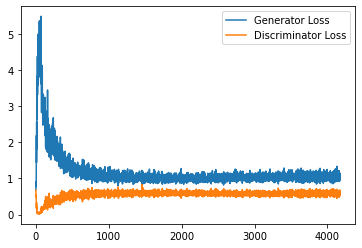

Step 84000: Generator loss: 1.0502718756198883, discriminator loss: 0.5804002488851547


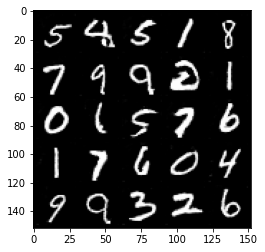

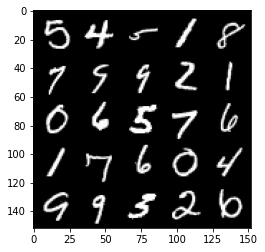

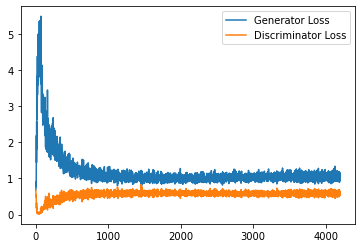

Step 84500: Generator loss: 1.0421888409852982, discriminator loss: 0.5806135971546174


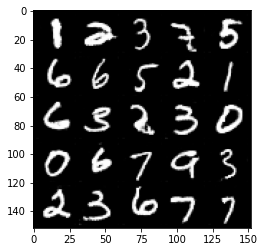

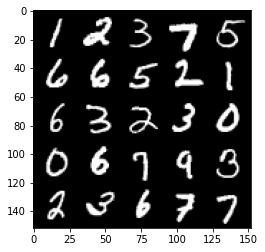

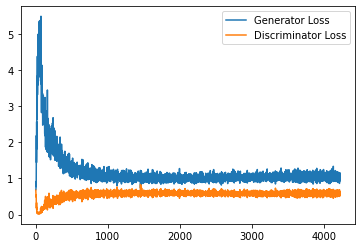

Step 85000: Generator loss: 1.0606628308296204, discriminator loss: 0.5873020523190499


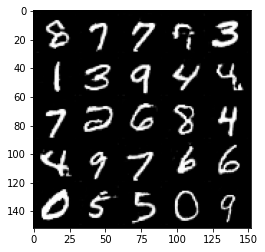

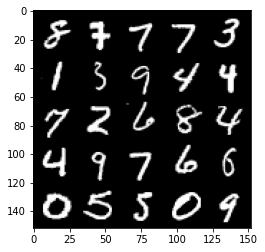

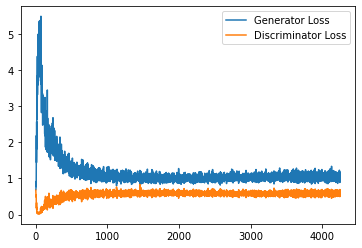

Step 85500: Generator loss: 1.050755389213562, discriminator loss: 0.5788793649077415


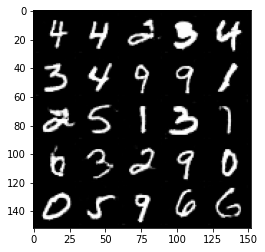

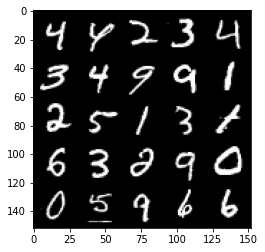

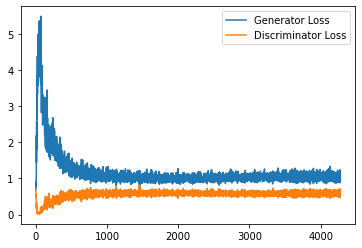

Step 86000: Generator loss: 1.0538319312334061, discriminator loss: 0.5802568856477738


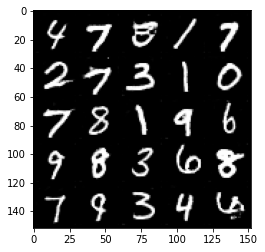

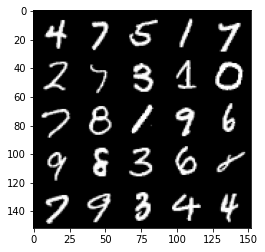

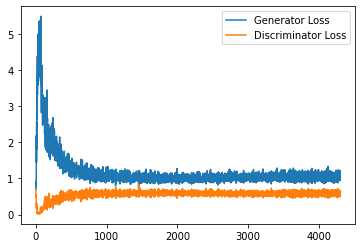

Step 86500: Generator loss: 1.0399963392019271, discriminator loss: 0.5875660058259964


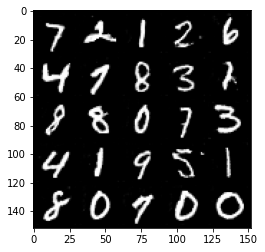

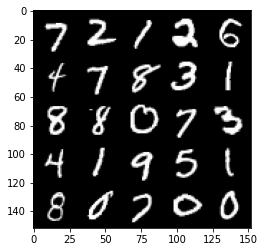

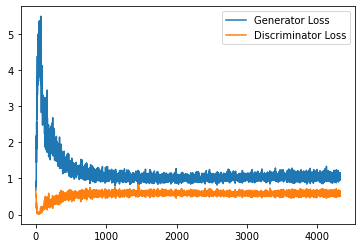

Step 87000: Generator loss: 1.0490001454353333, discriminator loss: 0.5799704748392105


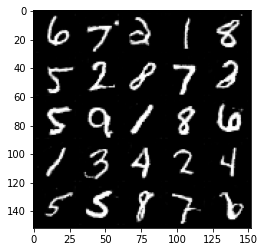

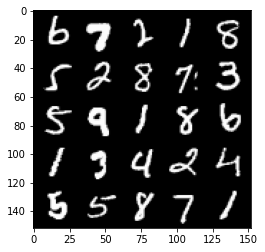

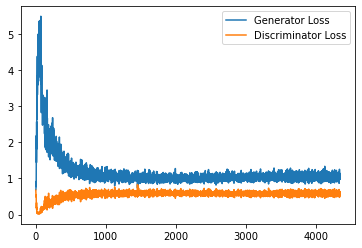

Step 87500: Generator loss: 1.0526433107852935, discriminator loss: 0.585069902420044


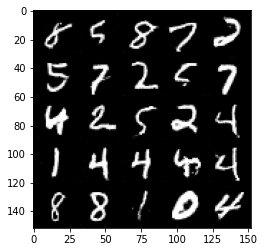

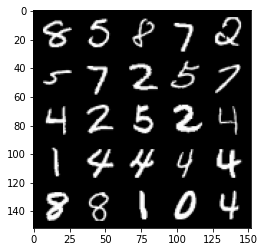

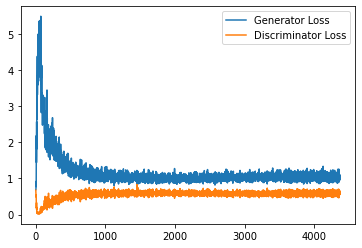

Step 88000: Generator loss: 1.081961056470871, discriminator loss: 0.5817570376992226


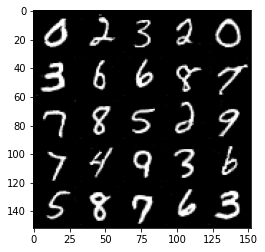

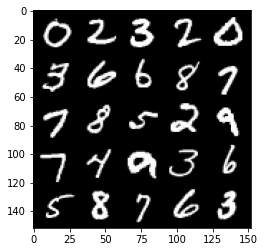

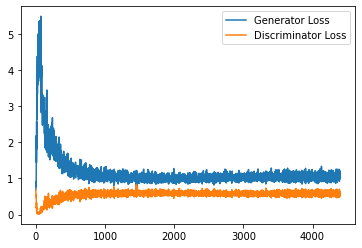

Step 88500: Generator loss: 1.0355769152641296, discriminator loss: 0.5831668527722359


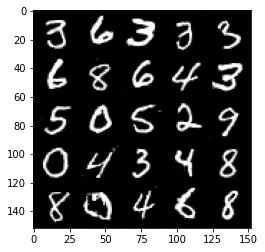

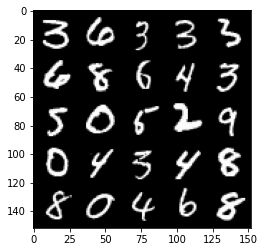

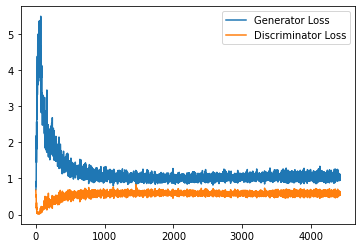

Step 89000: Generator loss: 1.0463406319618225, discriminator loss: 0.583212619960308


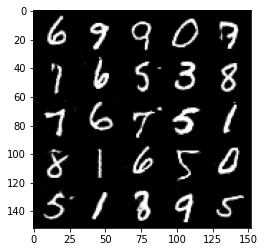

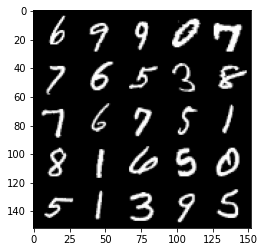

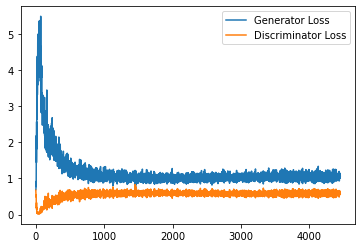

Step 89500: Generator loss: 1.0407195502519608, discriminator loss: 0.5919485304951668


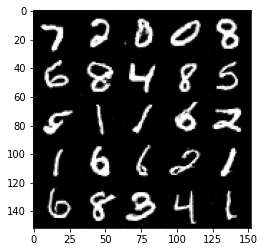

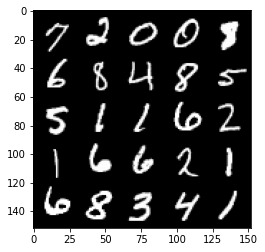

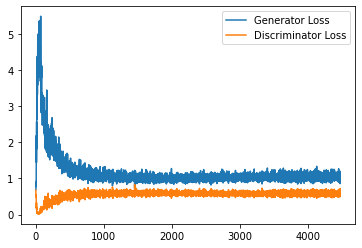

Step 90000: Generator loss: 1.0483468654155732, discriminator loss: 0.5829432265758514


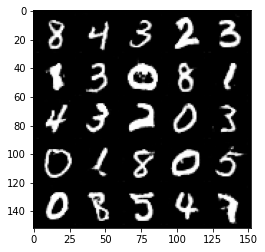

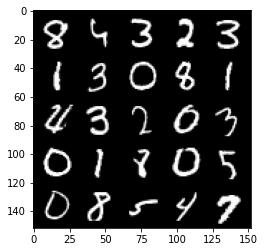

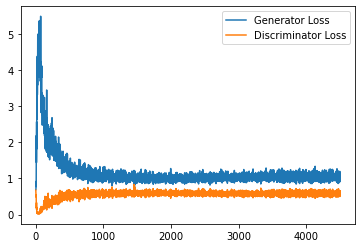

Step 90500: Generator loss: 1.0476520527601243, discriminator loss: 0.5851443635821343


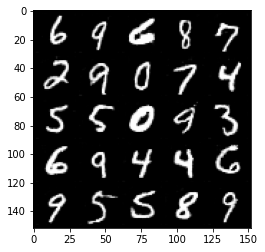

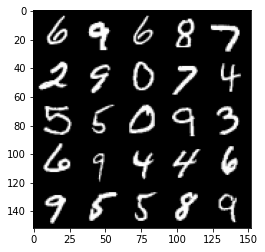

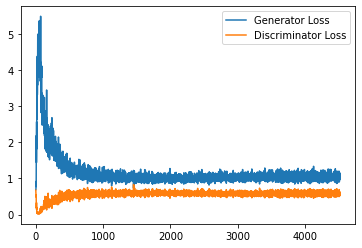

Step 91000: Generator loss: 1.061170170903206, discriminator loss: 0.5866566989421844


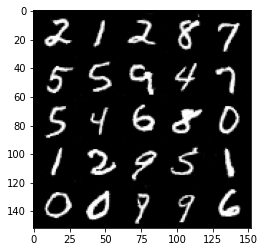

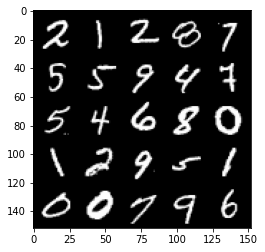

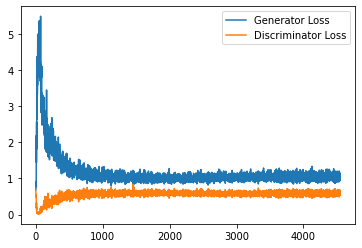

Step 91500: Generator loss: 1.0632388589382171, discriminator loss: 0.5836649401187897


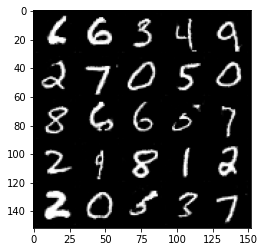

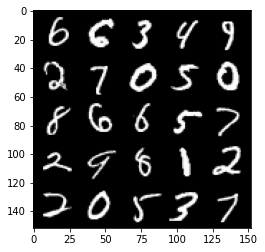

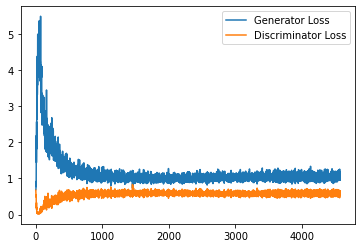

Step 92000: Generator loss: 1.0484435737133027, discriminator loss: 0.5858256911635399


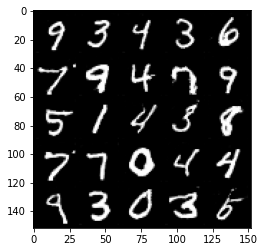

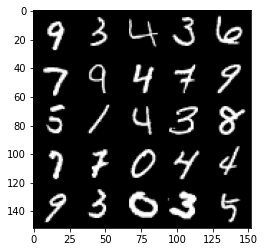

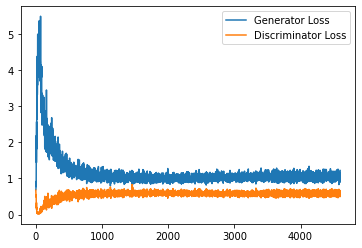

Step 92500: Generator loss: 1.0550917677879335, discriminator loss: 0.5846130967736244


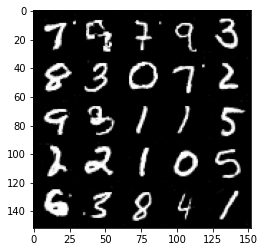

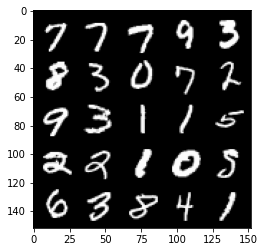

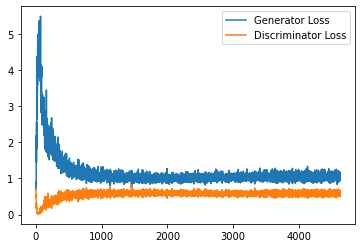

Step 93000: Generator loss: 1.0453072667121888, discriminator loss: 0.5888648955225945


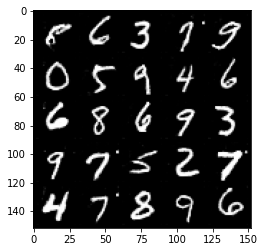

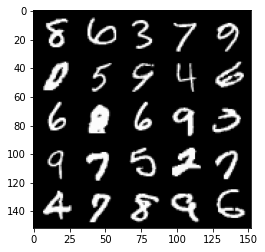

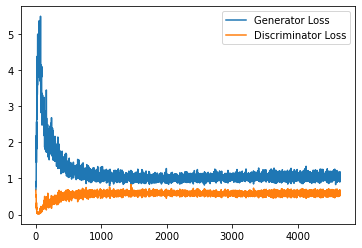

Step 93500: Generator loss: 1.0585262941122056, discriminator loss: 0.5887793312668801


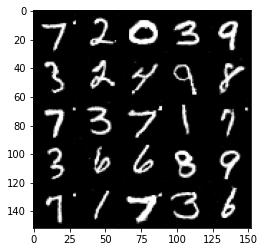

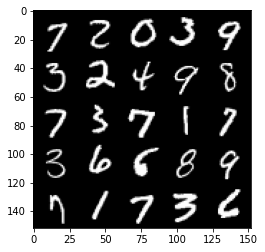

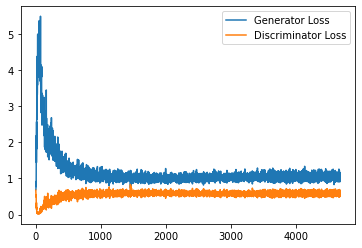

In [21]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [22]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

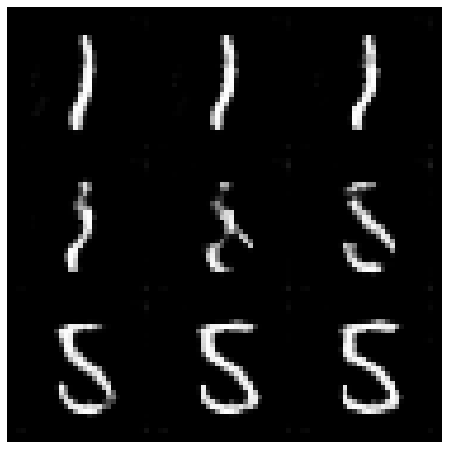

In [23]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

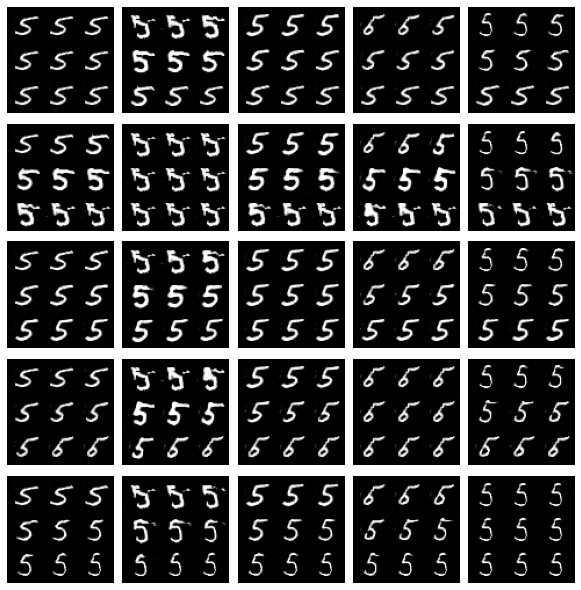

In [24]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()